#  Avacado Case Study

## Prelude:
The dataset given is about the consumption statistics for the avocado fruit in United States of America. avocado is widely used for variety of usage. There are multiple types of avocado consumed in the states. We are given details on pricing, volume, types and regions over the years. Hre we understand different facets of the project. 

## Variables:

### About the Independent Variables:

1. Date- Date of observation

2. Type: A categorical variable with two categories "conventional" or "organic"

3. Year- It is a categorical variable having four categories from 2015 to 2018

4. Total Volume- This is a continuous variable informing us about the total number of avocados sold

5. 4046- This is a continuous variable describing total avocados sold having product lookup code to be 4046

6. 4225- This is a continuous variable describing total avocados sold having product lookup code to be 4225

7. 4770- This is a continuous variable describing total avocados sold having product lookup code to be 4770

8. Total Bags- This is a continuous variable describing a total of small, large and extra large bags of avocados sold

9. Small Bags- This is a coontinuous variable describing a small bags of avocados sold

10. Large Bags- This is a coontinuous variable describing a large bags of avocados sold

11. Extra Large Bags- This is a coontinuous variable describing a extra large bags of avocados sold

### About the dependent variable:

For part 1 (Regression Model)

Average Price- Price per avacado. It is a continuous variable

For part 2 (Classification Model)

Region- This is a categorical variable having 54 categories

In [123]:
# Importing necessary packages

# Importing fundamental packages
import warnings
warnings.filterwarnings("ignore")
from IPython.core.interactiveshell import InteractiveShell        ## To display multiple outputs
InteractiveShell.ast_node_interactivity = "all"
import pyforest            

## For visualization
import matplotlib.pyplot as plt                                         
%matplotlib inline

import seaborn as sns

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

## Data Pre-Processing Packages
from scipy.stats import chi2_contingency
from sklearn import metrics
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from scipy.stats import zscore
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import LabelBinarizer
from sklearn.preprocessing import LabelEncoder
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import KNNImputer
from sklearn.datasets import make_blobs
from sklearn.cluster import DBSCAN
from collections import Counter
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import KFold
from sklearn.feature_selection import RFE
from sklearn.preprocessing import scale
from sklearn.datasets import make_classification
from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE

## To create copy of data
import copy

## Pipeline Packages

from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline


## Ensemble Learning Algorithms Packages

from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
import xgboost as xgb
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import loguniform
from sklearn.linear_model import Ridge
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import GradientBoostingRegressor

## Evaluation Metrics Packages
import statsmodels.api as sm
from scipy.stats import f
from statsmodels.formula.api import ols
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.utils import resample
from sklearn import metrics
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import preprocessing
from sklearn.metrics import average_precision_score, confusion_matrix, accuracy_score, classification_report, plot_confusion_matrix
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import silhouette_score
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score

# Bagging and Boosting
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import AdaBoostClassifier                           

# Saving the model
import pickle

### Uploading the dataset in python environment

In [2]:
def read(link):
    global data

    data=pd.read_csv(link)
    
    data=pd.DataFrame(data)
    print(data)

In [3]:
read(link="avocado.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

       Unnamed: 0        Date  AveragePrice  Total Volume     4046       4225  \
0               0  2015-12-27          1.33      64236.62  1036.74   54454.85   
1               1  2015-12-20          1.35      54876.98   674.28   44638.81   
2               2  2015-12-13          0.93     118220.22   794.70  109149.67   
3               3  2015-12-06          1.08      78992.15  1132.00   71976.41   
4               4  2015-11-29          1.28      51039.60   941.48   43838.39   
...           ...         ...           ...           ...      ...        ...   
18244           7  2018-02-04          1.63      17074.83  2046.96    1529.20   
18245           8  2018-01-28          1.71      13888.04  1191.70    3431.50   
18246           9  2018-01-21          1.87      13766.76  1191.92    2452.79   
18247          10  2018-01-14          1.93      16205.22  1527.63    2981.04   
18248          11  2018-01-07          1.62      17489.58  2894.77    2356.13   

         4770  Total Bags  

In [4]:
print(data.head())                              # to display first 10 records

   Unnamed: 0        Date  AveragePrice  Total Volume     4046       4225  \
0           0  2015-12-27          1.33      64236.62  1036.74   54454.85   
1           1  2015-12-20          1.35      54876.98   674.28   44638.81   
2           2  2015-12-13          0.93     118220.22   794.70  109149.67   
3           3  2015-12-06          1.08      78992.15  1132.00   71976.41   
4           4  2015-11-29          1.28      51039.60   941.48   43838.39   

     4770  Total Bags  Small Bags  Large Bags  XLarge Bags          type  \
0   48.16     8696.87     8603.62       93.25          0.0  conventional   
1   58.33     9505.56     9408.07       97.49          0.0  conventional   
2  130.50     8145.35     8042.21      103.14          0.0  conventional   
3   72.58     5811.16     5677.40      133.76          0.0  conventional   
4   75.78     6183.95     5986.26      197.69          0.0  conventional   

   year  region  
0  2015  Albany  
1  2015  Albany  
2  2015  Albany  
3  2015 

In [5]:
print(data.tail())                              # to display last 10 records

       Unnamed: 0        Date  AveragePrice  Total Volume     4046     4225  \
18244           7  2018-02-04          1.63      17074.83  2046.96  1529.20   
18245           8  2018-01-28          1.71      13888.04  1191.70  3431.50   
18246           9  2018-01-21          1.87      13766.76  1191.92  2452.79   
18247          10  2018-01-14          1.93      16205.22  1527.63  2981.04   
18248          11  2018-01-07          1.62      17489.58  2894.77  2356.13   

         4770  Total Bags  Small Bags  Large Bags  XLarge Bags     type  year  \
18244    0.00    13498.67    13066.82      431.85          0.0  organic  2018   
18245    0.00     9264.84     8940.04      324.80          0.0  organic  2018   
18246  727.94     9394.11     9351.80       42.31          0.0  organic  2018   
18247  727.01    10969.54    10919.54       50.00          0.0  organic  2018   
18248  224.53    12014.15    11988.14       26.01          0.0  organic  2018   

                 region  
18244  WestT

In [6]:
print(data.info())                               # to understand attributes of the data

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18249 entries, 0 to 18248
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    18249 non-null  int64  
 1   Date          18249 non-null  object 
 2   AveragePrice  18249 non-null  float64
 3   Total Volume  18249 non-null  float64
 4   4046          18249 non-null  float64
 5   4225          18249 non-null  float64
 6   4770          18249 non-null  float64
 7   Total Bags    18249 non-null  float64
 8   Small Bags    18249 non-null  float64
 9   Large Bags    18249 non-null  float64
 10  XLarge Bags   18249 non-null  float64
 11  type          18249 non-null  object 
 12  year          18249 non-null  int64  
 13  region        18249 non-null  object 
dtypes: float64(9), int64(2), object(3)
memory usage: 1.9+ MB
None


In [7]:
print(data.describe())                          # to get descriptive statistics

         Unnamed: 0  AveragePrice  Total Volume          4046          4225  \
count  18249.000000  18249.000000  1.824900e+04  1.824900e+04  1.824900e+04   
mean      24.232232      1.405978  8.506440e+05  2.930084e+05  2.951546e+05   
std       15.481045      0.402677  3.453545e+06  1.264989e+06  1.204120e+06   
min        0.000000      0.440000  8.456000e+01  0.000000e+00  0.000000e+00   
25%       10.000000      1.100000  1.083858e+04  8.540700e+02  3.008780e+03   
50%       24.000000      1.370000  1.073768e+05  8.645300e+03  2.906102e+04   
75%       38.000000      1.660000  4.329623e+05  1.110202e+05  1.502069e+05   
max       52.000000      3.250000  6.250565e+07  2.274362e+07  2.047057e+07   

               4770    Total Bags    Small Bags    Large Bags    XLarge Bags  \
count  1.824900e+04  1.824900e+04  1.824900e+04  1.824900e+04   18249.000000   
mean   2.283974e+04  2.396392e+05  1.821947e+05  5.433809e+04    3106.426507   
std    1.074641e+05  9.862424e+05  7.461785e+05 

In [8]:
print("Skewness for the data","\n",data.skew())       # to get skewness of the data, skewness=0 for normal distribution

Skewness for the data 
 Unnamed: 0       0.108334
AveragePrice     0.580303
Total Volume     9.007687
4046             8.648220
4225             8.942466
4770            10.159396
Total Bags       9.756072
Small Bags       9.540660
Large Bags       9.796455
XLarge Bags     13.139751
year             0.215339
dtype: float64


In [9]:
print("Kurosis for the data","\n",data.kurtosis() )            # to get kutosis, kurtosis <=3 for normal distribution

Kurosis for the data 
 Unnamed: 0       -1.254364
AveragePrice      0.325196
Total Volume     92.104458
4046             86.809113
4225             91.949022
4770            132.563441
Total Bags      112.272156
Small Bags      107.012885
Large Bags      117.999481
XLarge Bags     233.602612
year             -1.032747
dtype: float64


In [10]:
# To get data counts in percentage
print("For Region :")
print(data["region"].value_counts(abs))

For Region :
Albany                 0.018522
Sacramento             0.018522
Northeast              0.018522
NorthernNewEngland     0.018522
Orlando                0.018522
Philadelphia           0.018522
PhoenixTucson          0.018522
Pittsburgh             0.018522
Plains                 0.018522
Portland               0.018522
RaleighGreensboro      0.018522
RichmondNorfolk        0.018522
Roanoke                0.018522
SanDiego               0.018522
Atlanta                0.018522
SanFrancisco           0.018522
Seattle                0.018522
SouthCarolina          0.018522
SouthCentral           0.018522
Southeast              0.018522
Spokane                0.018522
StLouis                0.018522
Syracuse               0.018522
Tampa                  0.018522
TotalUS                0.018522
West                   0.018522
NewYork                0.018522
NewOrleansMobile       0.018522
Nashville              0.018522
Midsouth               0.018522
BaltimoreWashington    0.01

In [11]:
# To get data counts in percentage
print("For Average Price :")
print(data["AveragePrice"].value_counts(abs))

For Average Price :
1.15    0.011069
1.18    0.010905
1.08    0.010631
1.26    0.010576
1.13    0.010521
          ...   
3.25    0.000055
3.12    0.000055
2.68    0.000055
3.03    0.000055
3.17    0.000055
Name: AveragePrice, Length: 259, dtype: float64


## Data Visualization

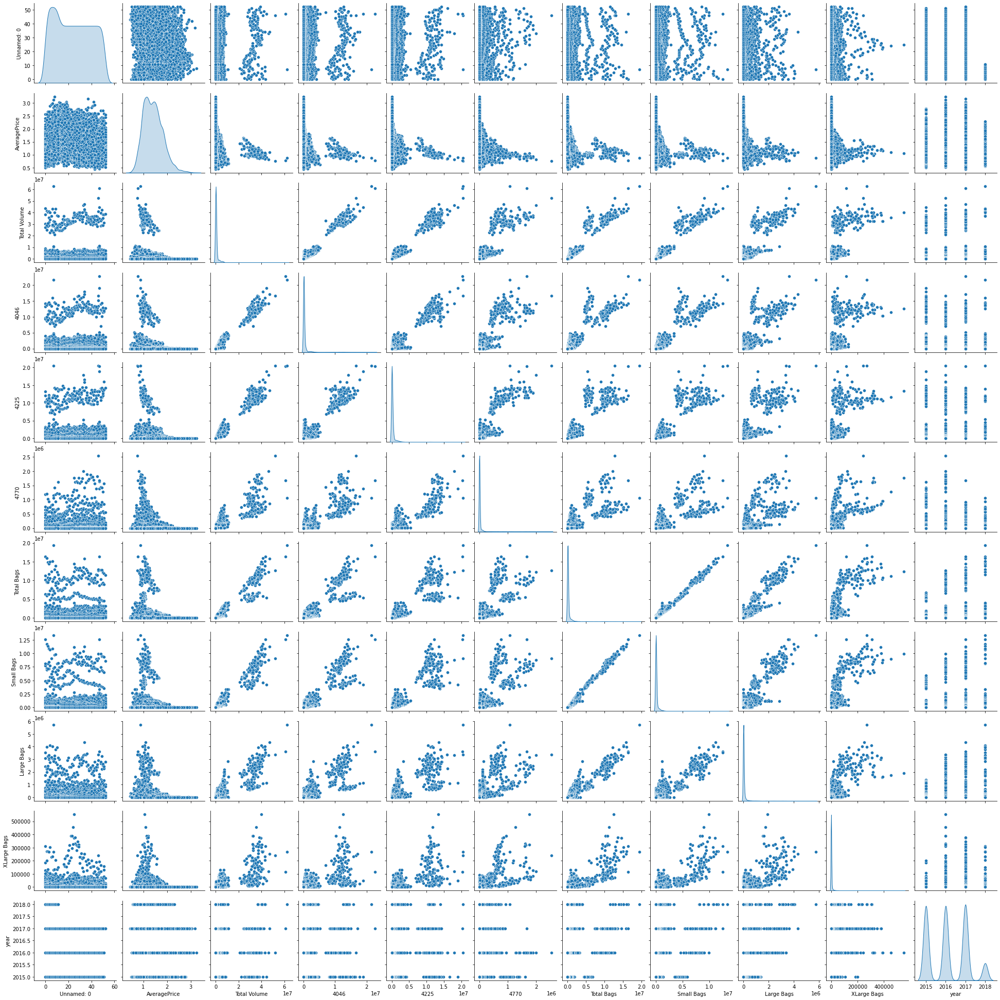

In [12]:
sns.pairplot(data, kind='scatter', diag_kind='kde')                       # to represent data graphically
print("\n")
print("\n")        

<Figure size 720x720 with 0 Axes>

<AxesSubplot:>

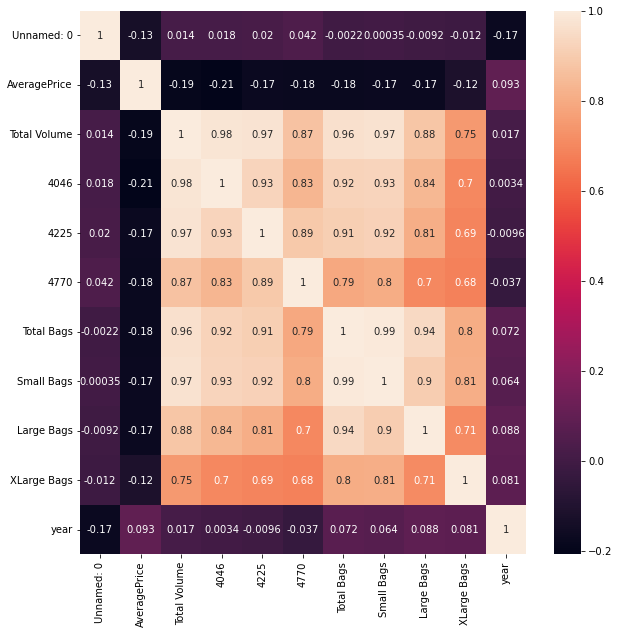

In [13]:
plt.figure(figsize=(10,10))                      # plotting heat map to check correlation
sns.heatmap(data.corr(method = "pearson"), annot = True)
print("\n")

<AxesSubplot:xlabel='Unnamed: 0', ylabel='AveragePrice'>

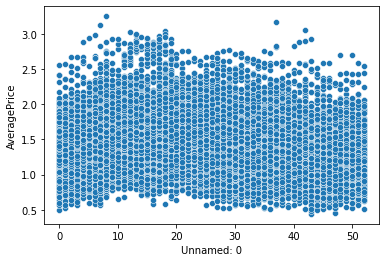

In [14]:
# Scatterplot for Unnamed: 0 and AveragePrice

sns.scatterplot(x="Unnamed: 0",y="AveragePrice",data=data)

<AxesSubplot:xlabel='Unnamed: 0', ylabel='Density'>

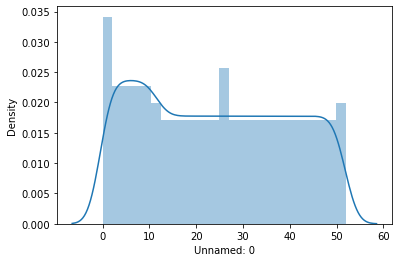

In [15]:
# Distplot for Unnamed: 0
sns.distplot(data["Unnamed: 0"])

<AxesSubplot:xlabel='Date', ylabel='AveragePrice'>

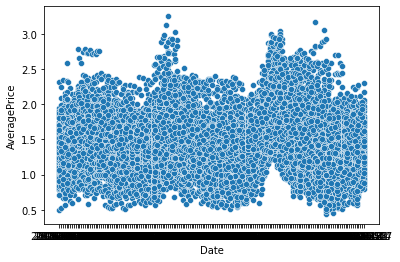

In [16]:
# Scatterplot for Date and AveragePrice

sns.scatterplot(x="Date",y="AveragePrice",data=data)

<AxesSubplot:xlabel='AveragePrice', ylabel='Density'>

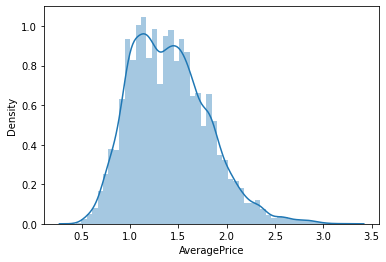

In [17]:
# Distplot for AveragePrice
sns.distplot(data["AveragePrice"])

<AxesSubplot:xlabel='Total Volume', ylabel='AveragePrice'>

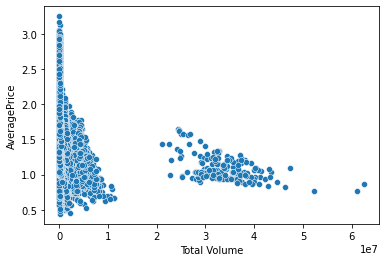

In [18]:
# Scatterplot for Total Volume and AveragePrice

sns.scatterplot(x="Total Volume",y="AveragePrice",data=data)

<AxesSubplot:xlabel='Total Volume', ylabel='Density'>

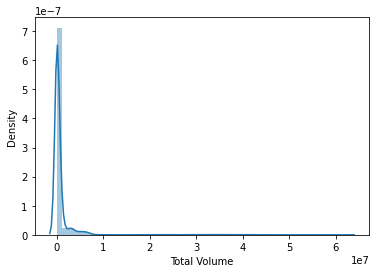

In [19]:
# Distplot for Total Volume
sns.distplot(data["Total Volume"])

<AxesSubplot:xlabel='4046', ylabel='AveragePrice'>

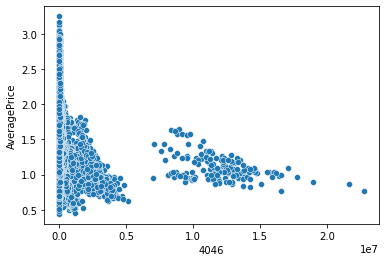

In [20]:
# Scatterplot for 4046 and AveragePrice

sns.scatterplot(x="4046",y="AveragePrice",data=data)

<AxesSubplot:xlabel='4046', ylabel='Density'>

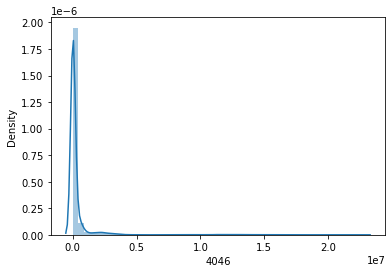

In [21]:
# Distplot for 4046
sns.distplot(data["4046"])

<AxesSubplot:xlabel='4225', ylabel='AveragePrice'>

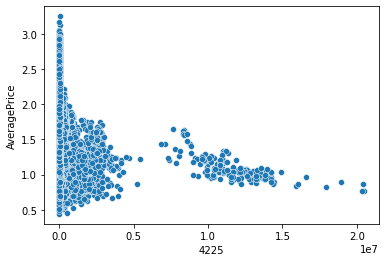

In [22]:
# Scatterplot for 4225 and AveragePrice

sns.scatterplot(x="4225",y="AveragePrice",data=data)

<AxesSubplot:xlabel='4225', ylabel='Density'>

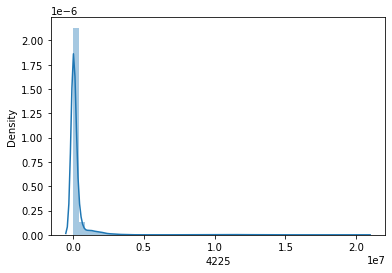

In [23]:
# Distplot for 4225
sns.distplot(data["4225"])

<AxesSubplot:xlabel='4770', ylabel='AveragePrice'>

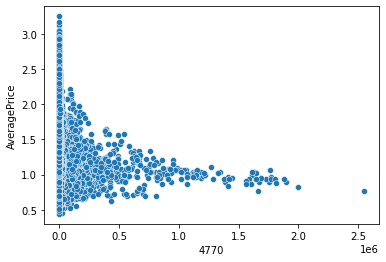

In [24]:
# Scatterplot for 4770 and AveragePrice

sns.scatterplot(x="4770",y="AveragePrice",data=data)

<AxesSubplot:xlabel='4770', ylabel='Density'>

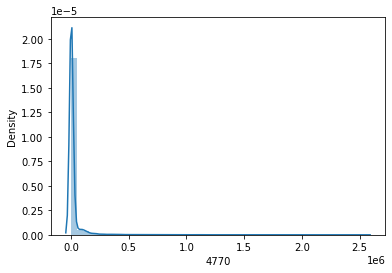

In [25]:
# Distplot for 4770
sns.distplot(data["4770"])

<AxesSubplot:xlabel='Total Bags', ylabel='AveragePrice'>

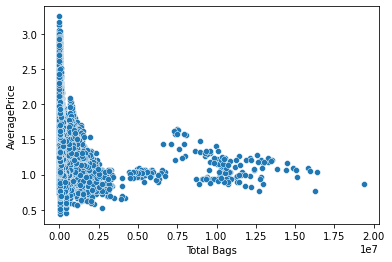

In [26]:
# Scatterplot for Total Bags and AveragePrice

sns.scatterplot(x="Total Bags",y="AveragePrice",data=data)

<AxesSubplot:xlabel='Total Bags', ylabel='Density'>

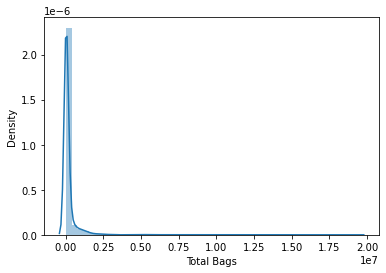

In [27]:
# Distplot for Total Bags
sns.distplot(data["Total Bags"])

<AxesSubplot:xlabel='Small Bags', ylabel='AveragePrice'>

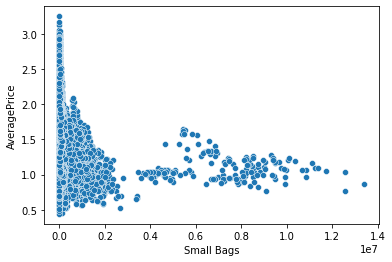

In [28]:
# Scatterplot for Small Bags and AveragePrice

sns.scatterplot(x="Small Bags",y="AveragePrice",data=data)

<AxesSubplot:xlabel='Small Bags', ylabel='Density'>

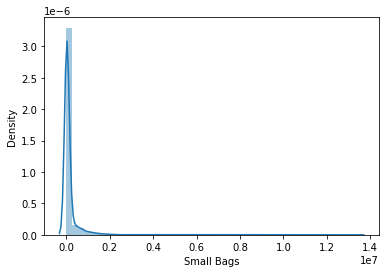

In [29]:
# Distplot for Small Bags
sns.distplot(data["Small Bags"])

<AxesSubplot:xlabel='Large Bags', ylabel='AveragePrice'>

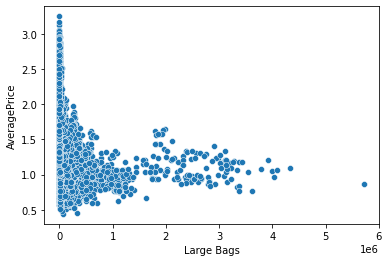

In [30]:
# Scatterplot for Large Bags and AveragePrice

sns.scatterplot(x="Large Bags",y="AveragePrice",data=data)

<AxesSubplot:xlabel='Large Bags', ylabel='Density'>

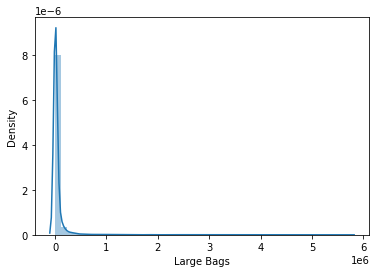

In [31]:
# Distplot for Large Bags
sns.distplot(data["Large Bags"])

<AxesSubplot:xlabel='XLarge Bags', ylabel='AveragePrice'>

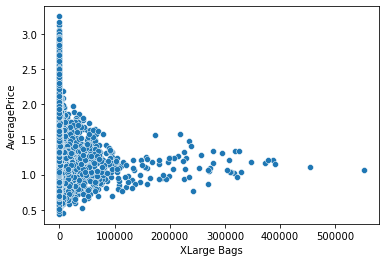

In [32]:
# Scatterplot for XLarge Bags and 

sns.scatterplot(x="XLarge Bags",y="AveragePrice",data=data)

<AxesSubplot:xlabel='XLarge Bags', ylabel='Density'>

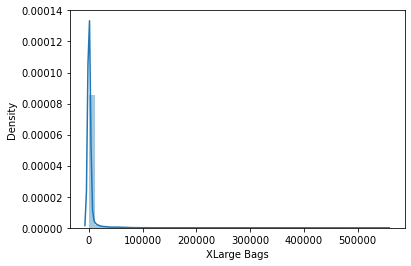

In [33]:
# Distplot for XLarge Bags
sns.distplot(data["XLarge Bags"])

<AxesSubplot:xlabel='type', ylabel='AveragePrice'>

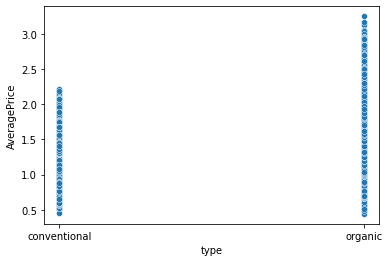

In [34]:
# Scatterplot for type and AveragePrice

sns.scatterplot(x="type",y="AveragePrice",data=data)

<AxesSubplot:xlabel='year', ylabel='AveragePrice'>

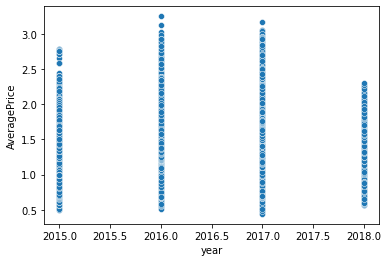

In [35]:
# Scatterplot for year and AveragePrice

sns.scatterplot(x="year",y="AveragePrice",data=data)

<AxesSubplot:xlabel='year', ylabel='Density'>

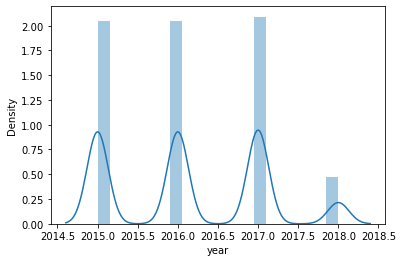

In [36]:
# Distplot for year
sns.distplot(data["year"])

<AxesSubplot:xlabel='region', ylabel='AveragePrice'>

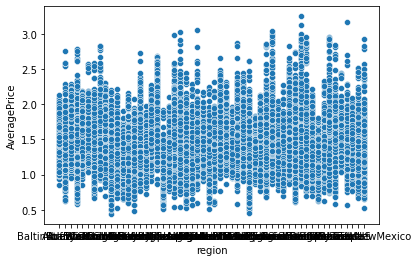

In [37]:
# Scatterplot for region and AveragePrice

sns.scatterplot(x="region",y="AveragePrice",data=data)

In [38]:
# Box Plots
fig = px.box(data, y= "Unnamed: 0", width=600, height=400, title="Unnamed: 0", template="plotly_dark")
fig.show()

In [39]:
# Box Plots
fig = px.box(data, y= "Date", width=600, height=400, title="Date", template="plotly_dark")
fig.show()

In [40]:
# Box Plots
fig = px.box(data, y= "Total Volume", width=600, height=400, title="Total Volume", template="plotly_dark")
fig.show()

In [41]:
# Box Plots
fig = px.box(data, y= "4046", width=600, height=400, title="4046", template="plotly_dark")
fig.show()

In [42]:
# Box Plots
fig = px.box(data, y= "4225", width=600, height=400, title="4225", template="plotly_dark")
fig.show()

In [43]:
# Box Plots
fig = px.box(data, y= "4770", width=600, height=400, title="4770", template="plotly_dark")
fig.show()

In [44]:
# Box Plots
fig = px.box(data, y= "Total Bags", width=600, height=400, title="Total Bags", template="plotly_dark")
fig.show()

In [45]:
# Box Plots
fig = px.box(data, y= "Large Bags", width=600, height=400, title="Large Bags", template="plotly_dark")
fig.show()

In [46]:
# Box Plots
fig = px.box(data, y= "Small Bags", width=600, height=400, title="Small Bags", template="plotly_dark")
fig.show()

In [47]:
# Box Plots
fig = px.box(data, y= "XLarge Bags", width=600, height=400, title="XLarge Bags", template="plotly_dark")
fig.show()

In [48]:
# Box Plots
fig = px.box(data, y= "type", width=600, height=400, title="type", template="plotly_dark")
fig.show()

In [49]:
# Box Plots
fig = px.box(data, y= "year", width=600, height=400, title="year", template="plotly_dark")
fig.show()

In [50]:
# Box Plots
fig = px.box(data, y= "region", width=600, height=400, title="region", template="plotly_dark")
fig.show()

## Hypothesis testing

In [51]:
# Anova for Average Price and Region
# h0: Region is not significant to average price
# ha: Region is significant to average price

mod=ols('AveragePrice~region',data=data).fit()

# Performing Anova
avotable= sm.stats.anova_lm(mod)
print("\n")
# Print result
print(avotable)



               df       sum_sq   mean_sq          F  PR(>F)
region       53.0   497.469772  9.386222  69.383811     0.0
Residual  18195.0  2461.414383  0.135280        NaN     NaN


In [52]:
# Anova for Average Price and Year
# h0: Year is not significant to average price
# ha: Year is significant to average price


mod=ols('AveragePrice~year',data=data).fit()

# Performing Anova
avotable= sm.stats.anova_lm(mod)
print("\n")
# Print result
print(avotable)



               df       sum_sq    mean_sq           F        PR(>F)
year          1.0    25.699914  25.699914  159.876195  1.713145e-36
Residual  18247.0  2933.184241   0.160749         NaN           NaN


In [53]:
# Anova for Average Price and Date
# h0: Date is not significant to average price
# ha: Date is significant to average price


mod=ols('AveragePrice~Date',data=data).fit()

# Performing Anova
avotable= sm.stats.anova_lm(mod)
print("\n")
# Print result
print(avotable)



               df       sum_sq   mean_sq          F  PR(>F)
Date        168.0   417.562839  2.485493  17.682815     0.0
Residual  18080.0  2541.321316  0.140560        NaN     NaN


In [54]:
data_1=pd.DataFrame(data)

<IPython.core.display.Javascript object>

In [55]:
data_1.columns

Index(['Unnamed: 0', 'Date', 'AveragePrice', 'Total Volume', '4046', '4225',
       '4770', 'Total Bags', 'Small Bags', 'Large Bags', 'XLarge Bags', 'type',
       'year', 'region'],
      dtype='object')

In [56]:
data_1=data.drop(["Total Volume","Total Bags","4046","Small Bags"],axis=1)

In [57]:
data_1=pd.get_dummies(data.drop(['region','Date'],axis=1),drop_first=True)

<IPython.core.display.Javascript object>

### Outlier Treatment


In [58]:
for i in data_1.drop(['AveragePrice'],axis=1).columns:
    data_1[i] = np.where(data_1[i] > (data_1[i].quantile(0.75) + (data_1[i].quantile(0.75) - data_1[i].quantile(0.25))*1.5),
                           (data_1[i].quantile(0.75) + (data_1[i].quantile(0.75) - data_1[i].quantile(0.25))*1.5),
                          np.where(data_1[i] < (data_1[i].quantile(0.25) - (data_1[i].quantile(0.75) - data_1[i].quantile(0.25))*1.5),
                           (data_1[i].quantile(0.25) - (data_1[i].quantile(0.75) - data_1[i].quantile(0.25))*1.5),data_1[i]))
    

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [59]:
data_features=data_1.drop(["AveragePrice"], axis=1)

array([[ 1.00962718,  1.56402879],
       [-1.53774087, -0.41290165],
       [ 0.71988722,  1.22250197],
       [-1.32807751, -0.66586152],
       [ 0.5181697 , -0.52845498]])

[0 1 0 1 2 1 1 1 1 0 2 1 2 0 0 2 0 2 2 1 2 0 2 1 2 0 0 1 0 1 1 0 2 2 1 0 2
 2 0 2 1 2 1 0 1 2 0 0 1 0]


3

0

Estimated number of clusters: 3
Estimated number of noise points: 0


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Text(0.5, 1.0, 'Estimated number of clusters: 3')

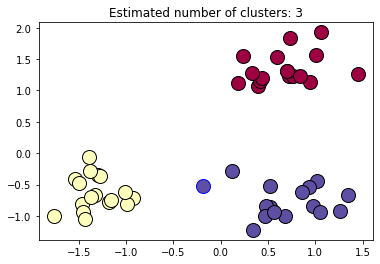

<IPython.core.display.Javascript object>

(array([0, 1, 2], dtype=int64), array([17, 17, 16], dtype=int64))

[]


In [60]:
# DB Scan

# Data creation
centers = [[1, 1], [-1, -1], [1, -1]]
data_features, labels_true, a = make_blobs(n_samples=50, centers=centers, cluster_std=0.3,random_state=5,shuffle=True , return_centers=True)  # generate sample blobs
X = StandardScaler().fit_transform(data_features)
X[:5]

# DBSCAN
db = DBSCAN(eps=0.7, min_samples=3, algorithm='ball_tree').fit(X)

labels = db.labels_  # similar to the model.fit() method, it gives the labels of the clustered data

print (labels)

# Setting Length of labels
len(set(labels))

1 if -1 in labels else 0

# Number of clusters in labels, ignoring noise if present.

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0) # the label -1 is considered as noise by the DBSCAN algorithm
n_noise_ = list(labels).count(-1)  # calculating the number of noises (-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)

# Below code is for showcasing in diagram. Nothing related to model building

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)  # creating an array of true and false as the same size as db.labels

core_samples_mask[db.core_sample_indices_] = True  # setting the indices of the core regions to True
# Black  is used for noise.
unique_labels = set(labels)  # identifying all the unique labels/clusters

colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]  # creating the list of colours, generating the colourmap



for k, col in zip(unique_labels, colors):
    
    
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)   # assigning class members for each class
    

    xy = X[class_member_mask & core_samples_mask] # creating the list of points for each class
    
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)
    

    xy = X[class_member_mask & ~core_samples_mask] # creating the list of noise points
    
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='b', markersize=14)
    
    

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

# Finding counts in each cluster
np.unique(labels, return_counts=True)

# Selecting only noises
noises = X[labels == 4]

print (noises)




### Removing Skewness

In [61]:
data_features2=data_1.drop(["AveragePrice"], axis=1)
data_label=data_1["AveragePrice"]

In [62]:
# Removing skewness using Yeo-Johnson
# Removing data skewness
pt = PowerTransformer(method='yeo-johnson',standardize='True')
    
data_noskew= pt.fit_transform(data_features2.values)
data_noskewtab= pd.DataFrame(data_noskew)


<IPython.core.display.Javascript object>

In [63]:
data_noskewtab.info()
data_features2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18249 entries, 0 to 18248
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       18249 non-null  float64
 1   1       18249 non-null  float64
 2   2       18249 non-null  float64
 3   3       18249 non-null  float64
 4   4       18249 non-null  float64
 5   5       18249 non-null  float64
 6   6       18249 non-null  float64
 7   7       18249 non-null  float64
 8   8       18249 non-null  float64
 9   9       18249 non-null  float64
 10  10      18249 non-null  float64
dtypes: float64(11)
memory usage: 1.5 MB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18249 entries, 0 to 18248
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    18249 non-null  float64
 1   Total Volume  18249 non-null  float64
 2   4046          18249 non-null  float64
 3   4225          18249 non-null  float64
 4

In [64]:
data_noskewtab.columns = ['Unnamed: 0', 'Total Volume', '4046','4225', '4770','Total Bags', 'Small Bags', 
                          'Large Bags', 'XLarge Bags','year','type_organic']

print(data_noskewtab)

       Unnamed: 0  Total Volume      4046      4225      4770  Total Bags  \
0       -1.968845     -0.146630 -0.737354  0.347372 -0.286648   -0.637273   
1       -1.792619     -0.222763 -0.854694  0.252614 -0.238316   -0.597400   
2       -1.648366      0.159021 -0.810504  0.700997 -0.031424   -0.666267   
3       -1.521609     -0.044956 -0.712712  0.485012 -0.182731   -0.810639   
4       -1.406451     -0.257435 -0.764111  0.244122 -0.171705   -0.784680   
...           ...           ...       ...       ...       ...         ...   
18244   -1.104831     -0.753675 -0.540557 -1.003643 -1.242467   -0.434052   
18245   -1.014414     -0.841751 -0.698199 -0.755715 -1.242467   -0.608965   
18246   -0.927735     -0.845454 -0.698146 -0.862228  0.426742   -0.602724   
18247   -0.844286     -0.776122 -0.626949 -0.800983  0.426393   -0.531867   
18248   -0.763669     -0.743332 -0.434744 -0.874640  0.110962   -0.489410   

       Small Bags  Large Bags  XLarge Bags      year  type_organic  
0     

In [65]:
data_clean=pd.DataFrame(data_noskewtab)
data_final=pd.DataFrame()
data_final=pd.concat([data_clean,data_label], axis=1)
print(data_final)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

       Unnamed: 0  Total Volume      4046      4225      4770  Total Bags  \
0       -1.968845     -0.146630 -0.737354  0.347372 -0.286648   -0.637273   
1       -1.792619     -0.222763 -0.854694  0.252614 -0.238316   -0.597400   
2       -1.648366      0.159021 -0.810504  0.700997 -0.031424   -0.666267   
3       -1.521609     -0.044956 -0.712712  0.485012 -0.182731   -0.810639   
4       -1.406451     -0.257435 -0.764111  0.244122 -0.171705   -0.784680   
...           ...           ...       ...       ...       ...         ...   
18244   -1.104831     -0.753675 -0.540557 -1.003643 -1.242467   -0.434052   
18245   -1.014414     -0.841751 -0.698199 -0.755715 -1.242467   -0.608965   
18246   -0.927735     -0.845454 -0.698146 -0.862228  0.426742   -0.602724   
18247   -0.844286     -0.776122 -0.626949 -0.800983  0.426393   -0.531867   
18248   -0.763669     -0.743332 -0.434744 -0.874640  0.110962   -0.489410   

       Small Bags  Large Bags  XLarge Bags      year  type_organic  \
0    

<AxesSubplot:ylabel='Density'>

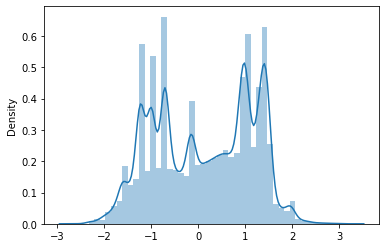

In [66]:
# Dist Plot
sns.distplot(data_final,kde=True, hist=True)

### Splitting Data into Train and Test

In [67]:
def split (data,target):
    data_reset_index = data.reset_index(drop=True)
# Data split
    global x
    global y
    global x_train
    global y_train
    global x_test
    global y_test
# Segregate Feature & Target Variables
    x = data_reset_index.drop(target, axis=1)
    y = data_reset_index[target]
    x_train,x_test,y_train,y_test = train_test_split(x,y, test_size=0.3, random_state=3)
    
    print(x_train.info())
    ("\n")
    print(x_test.info())
    ("\n")
    print(y_train.shape)
    ("\n")
    print(y_test.shape)
    ("\n")

In [68]:
split(data=data_final,
      target="AveragePrice")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12774 entries, 13042 to 5994
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    12774 non-null  float64
 1   Total Volume  12774 non-null  float64
 2   4046          12774 non-null  float64
 3   4225          12774 non-null  float64
 4   4770          12774 non-null  float64
 5   Total Bags    12774 non-null  float64
 6   Small Bags    12774 non-null  float64
 7   Large Bags    12774 non-null  float64
 8   XLarge Bags   12774 non-null  float64
 9   year          12774 non-null  float64
 10  type_organic  12774 non-null  float64
dtypes: float64(11)
memory usage: 1.2 MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 5475 entries, 2258 to 15115
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    5475 non-null   float64
 1   Total Volume  5475 non-null   float64


### Scaling the data

In [69]:
scale_1= StandardScaler()
scale_2= MinMaxScaler()
scale_3= RobustScaler()
model= LinearRegression()

In [70]:
pipe1 = Pipeline([
    ('Scale',scale_1),
    ('model',model),
])    
pipe2 = Pipeline([
    ('Scale',scale_2),
    ('model',model),
])
pipe3 = Pipeline([
    ('Scale',scale_3),
    ('model',model),  
    
])

In [71]:
# Create Function Name 
def pre_process(data, pipe):

# Pipe.fit, pipe.predict and accuracy
    
    pipe.fit(x_train,y_train)
    
    y_pred = pipe.predict(x_test)
    
    score = np.sqrt(metrics.mean_squared_error(y_pred, y_test))
    
    return score

In [72]:
pre_process(data= data_final,
           pipe= pipe1)

<IPython.core.display.Javascript object>

0.2707563341916849

In [73]:
pre_process(data= data_final,
           pipe= pipe2)

<IPython.core.display.Javascript object>

0.2707563341916849

In [74]:
pre_process(data= data_final,
           pipe= pipe3)

<IPython.core.display.Javascript object>

0.2707563341916849

In [75]:
scalar= StandardScaler()
scalar.fit(x_train)
x_trainsc =  scalar.transform(x_train)
x_testsc  =  scalar.transform(x_test)

StandardScaler()

### Principal Component Analysis (PCA)

In [76]:
pca = PCA(n_components = 0.5)
pca.fit(x_trainsc)
x_train_model = pca.transform(x_trainsc)
x_test_model = pca.transform(x_testsc)
ex_variance=np.var(x_train_model,axis=0)
ex_variance_ratio = ex_variance/np.sum(ex_variance)

print("shape of x_train_pca", x_train_model.shape)
print('')    
print("Explained Variance Ratio for Training Dataset: \n", ex_variance_ratio)

print(" ")

ex_variance_1 = np.var(x_test_model , axis=0)
ex_variance_ratio_1 = ex_variance_1 / np.sum(ex_variance_1)
    
print("Explained Variance Ratio for Test Dataset: \n", ex_variance_ratio_1) 
print(" ")

PCA(n_components=0.5)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

shape of x_train_pca (12774, 1)

Explained Variance Ratio for Training Dataset: 
 [1.]
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Explained Variance Ratio for Test Dataset: 
 [1.]
 


## Part 1 Model Building

In [77]:
lr = LinearRegression()
lr.fit(x_trainsc, y_train)


model = sm.OLS(y_train, x_trainsc).fit()


y_pred = model.predict(x_testsc)

print("Linear Regression Train Score: ", lr.score(x_trainsc , y_train))

print("Linear Regression Test Score: ", lr.score(x_testsc , y_test))

print('Mean Absolute Error:', np.round(metrics.mean_absolute_error(y_test, y_pred),2))  
print('Mean Squared Error:', np.round(metrics.mean_squared_error(y_test, y_pred),2))  
print('Root Mean Squared Error:', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2))
print(model.summary())

LinearRegression()

Linear Regression Train Score:  0.5281053510926801
Linear Regression Test Score:  0.5398291286039103


<IPython.core.display.Javascript object>

Mean Absolute Error: 1.4


<IPython.core.display.Javascript object>

Mean Squared Error: 2.05


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 1.43
                                 OLS Regression Results                                
Dep. Variable:           AveragePrice   R-squared (uncentered):                   0.040
Model:                            OLS   Adj. R-squared (uncentered):              0.040
Method:                 Least Squares   F-statistic:                              48.76
Date:                Sun, 07 Aug 2022   Prob (F-statistic):                   1.11e-105
Time:                        15:32:51   Log-Likelihood:                         -22719.
No. Observations:               12774   AIC:                                  4.546e+04
Df Residuals:                   12763   BIC:                                  4.554e+04
Df Model:                          11                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------

In [78]:
# Cross Validation
rfe = RFE(lr, n_features_to_select=6)             
rfe = rfe.fit(x, y)

r2 = sklearn.metrics.r2_score(y_test, y_pred)

scores = cross_val_score(lr, x, y, scoring='r2', cv=5)
scores   

# create a KFold object with 5 splits 
folds = KFold(n_splits = 5, shuffle = True, random_state = 100)
scores = cross_val_score(lr, x, y, scoring='r2', cv=folds)
scores  

scores = cross_val_score(lr, x, y, scoring='neg_mean_squared_error', cv=5)
scores

<IPython.core.display.Javascript object>

array([-0.09864386,  0.12297828,  0.43881544,  0.23328181,  0.19702601])

array([0.5300061 , 0.52944703, 0.53326266, 0.53634241, 0.52532461])

array([-0.04278123, -0.07810428, -0.07280053, -0.09453419, -0.13196383])

### Lasso

In [79]:
lasso_001 = Lasso()

lasso_001.fit(x_trainsc , y_train)


y_pred_lasso = lasso_001.predict(x_testsc)

print("LASSO Regression Train Score: ", lasso_001.score(x_trainsc , y_train))

print("LASSO Regression Test Score: ", lasso_001.score(x_testsc , y_test))


print('Mean Absolute Error:', np.round(metrics.mean_absolute_error(y_test, y_pred_lasso),2))  
print('Mean Squared Error:', np.round(metrics.mean_squared_error(y_test, y_pred_lasso),2))  
print('Root Mean Squared Error:', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_lasso)),2))

y_pred = lasso_001.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

coeff_used_002 = np.sum(lasso_001.coef_ != 0)

print("Coefficient used: ",coeff_used_002)

Lasso()

LASSO Regression Train Score:  0.0
LASSO Regression Test Score:  -1.1021447986481192e-05


<IPython.core.display.Javascript object>

Mean Absolute Error: 0.32


<IPython.core.display.Javascript object>

Mean Squared Error: 0.16


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 0.4


<IPython.core.display.Javascript object>

R2=  -1.1021447986481192e-05


<IPython.core.display.Javascript object>

Coefficient used:  0


In [80]:
rfe = RFE(lasso_001, n_features_to_select=6)             
rfe = rfe.fit(x, y)

r2 = sklearn.metrics.r2_score(y_test, y_pred)

scores = cross_val_score(lasso_001, x, y, scoring='r2', cv=5)
scores   

# create a KFold object with 5 splits 
folds = KFold(n_splits = 5, shuffle = True, random_state = 100)
scores = cross_val_score(lasso_001, x, y, scoring='r2', cv=folds)
scores  

scores = cross_val_score(lasso_001, x, y, scoring='neg_mean_squared_error', cv=5)
scores

<IPython.core.display.Javascript object>

array([-3.98236185, -0.75045983, -0.01749803, -0.47032699, -0.80592045])

array([-9.09434362e-05, -1.77956994e-07, -2.63698131e-04, -1.26128883e-05,
       -4.66405749e-04])

array([-0.19401333, -0.15588941, -0.13199649, -0.18128717, -0.29679191])

In [81]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 10)

# step-2: specify range of hyperparameters to tune
hyper_params = [{'alpha': range(0, 10), 'random_state':range(1, 20,2), 'selection': ['cyclic', 'random'] }]

# step-3: perform grid search
# 3.1 specify model
lasso_001 = Lasso()
lasso_001.fit(x_trainsc , y_train)
rfe = RFE(lasso_001)             

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = lasso_001, 
                        param_grid = hyper_params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, 
                        verbose = 1,
                        return_train_score=True)      

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Lasso()

Fitting 3 folds for each of 200 candidates, totalling 600 fits
Best Score:  -0.2152079811864623
Best Params:  {'alpha': 0, 'random_state': 15, 'selection': 'random'}


In [82]:
lasso_002 = Lasso(alpha = 0 , selection='random', random_state=15)

lasso_002.fit(x_trainsc , y_train)


y_pred_lasso = lasso_002.predict(x_testsc)

print("LASSO Regression Train Score: ", lasso_002.score(x_trainsc , y_train))

print("LASSO Regression Test Score: ", lasso_002.score(x_testsc , y_test))

y_pred = lasso_002.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

print('Mean Absolute Error:', np.round(metrics.mean_absolute_error(y_test, y_pred_lasso),2))  
print('Mean Squared Error:', np.round(metrics.mean_squared_error(y_test, y_pred_lasso),2))  
print('Root Mean Squared Error:', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_lasso)),2))



coeff_used_002 = np.sum(lasso_002.coef_ != 0)

print("Coefficient used: ",coeff_used_002)


Lasso(alpha=0, random_state=15, selection='random')

LASSO Regression Train Score:  0.5281053510925866
LASSO Regression Test Score:  0.5398291396023587


<IPython.core.display.Javascript object>

R2=  0.5398291396023587


<IPython.core.display.Javascript object>

Mean Absolute Error: 0.21


<IPython.core.display.Javascript object>

Mean Squared Error: 0.07


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 0.27


<IPython.core.display.Javascript object>

Coefficient used:  11


### Ridge 

In [83]:
rr1 = Ridge()                                                   # alpha = regularization hyper-parameter

rr1.fit(x_trainsc, y_train)


y_pred_rr = rr1.predict(x_testsc)

print("Ridge Regression Train Score: ", rr1.score(x_trainsc, y_train))
print("Ridge Regression Test Score: ", rr1.score(x_testsc, y_test))
print("\n")
print('Mean Absolute Error:', np.round(metrics.mean_absolute_error(y_test, y_pred_rr),2))  
print('Mean Squared Error:', np.round(metrics.mean_squared_error(y_test, y_pred_rr),2))
print('Root Mean Squared Error:', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_rr)),2))
y_pred = rr1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

coeff_used_001 = np.sum(rr1.coef_ != 0)

print("Coefficient used:","\n",coeff_used_001)

Ridge()

Ridge Regression Train Score:  0.5281047804397052
Ridge Regression Test Score:  0.539814774215082




<IPython.core.display.Javascript object>

Mean Absolute Error: 0.21


<IPython.core.display.Javascript object>

Mean Squared Error: 0.07


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 0.27


<IPython.core.display.Javascript object>

R2=  0.539814774215082


<IPython.core.display.Javascript object>

Coefficient used: 
 11


In [84]:
rfe = RFE(rr1, n_features_to_select=6)             
rfe = rfe.fit(x_trainsc, y_train)

r2 = sklearn.metrics.r2_score(y_test, y_pred)

scores = cross_val_score(rr1, x, y, scoring='r2', cv=5)
scores   

# create a KFold object with 5 splits 
folds = KFold(n_splits = 5, shuffle = True, random_state = 100)
scores = cross_val_score(rr1, x, y, scoring='r2', cv=folds)
scores  

scores = cross_val_score(rr1, x, y, scoring='neg_mean_squared_error', cv=5)
scores

<IPython.core.display.Javascript object>

array([-0.09940722,  0.12314802,  0.43888553,  0.23338284,  0.19692019])

array([0.53002029, 0.52947968, 0.53325405, 0.53631375, 0.52531029])

array([-0.04281095, -0.07808916, -0.07279144, -0.09452173, -0.13198122])

In [85]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 100)

# step-2: specify range of hyperparameters to tune
hyper_params = [{'random_state':list(range(5, 10)), 'tol': list(range(-10, 100,20)), 
                 'solver': ['auto', 'svd','cholesky', 'lsqr', 'sag', 'saga', 'lbfgs']}]


# step-3: perform grid search

# 3.1 specify model
rr1 = Ridge()
rr1.fit(x_trainsc, y_train)

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = rr1,
                        param_grid = hyper_params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds,
                        verbose=1,
                        return_train_score=True)      

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)        

Ridge()

Fitting 3 folds for each of 210 candidates, totalling 630 fits
Best Score:  -0.2153849591803861
Best Params:  {'random_state': 5, 'solver': 'auto', 'tol': 10}


In [86]:
rr2 = Ridge( random_state= 5, solver= 'auto', tol= 10)                                                   

rr2.fit(x_trainsc, y_train)


y_pred_rr = rr2.predict(x_testsc)

print("Ridge Regression Train Score: ", rr2.score(x_trainsc, y_train))
print("Ridge Regression Test Score: ", rr2.score(x_testsc, y_test))
print("\n")
print('Mean Absolute Error:', np.round(metrics.mean_absolute_error(y_test, y_pred_rr),2))  
print('Mean Squared Error:', np.round(metrics.mean_squared_error(y_test, y_pred_rr),2))
print('Root Mean Squared Error:', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_rr)),2))

y_pred = rr2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

coeff_used_001 = np.sum(rr2.coef_ != 0)

print("Coefficient used: ",coeff_used_001)

Ridge(random_state=5, tol=10)

Ridge Regression Train Score:  0.5281047804397052
Ridge Regression Test Score:  0.539814774215082




<IPython.core.display.Javascript object>

Mean Absolute Error: 0.21


<IPython.core.display.Javascript object>

Mean Squared Error: 0.07


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 0.27


<IPython.core.display.Javascript object>

R2=  0.539814774215082


<IPython.core.display.Javascript object>

Coefficient used:  11


### Elastic Net

In [87]:
lm_elastic1 = ElasticNet()

lm_elastic1.fit(x_trainsc, y_train)



y_pred_elastic = lm_elastic1.predict(x_testsc)


print("Elastic Net Train Score: ", lm_elastic1.score(x_trainsc , y_train))

print("Elastic Net Test Score: ", lm_elastic1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_pred_elastic),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_pred_elastic),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_elastic)),2))
print(" ")

y_pred = lm_elastic1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

coeff_used_003 = np.sum(lm_elastic1.coef_ != 0)

print("Coefficient used: ",coeff_used_003)

ElasticNet()

Elastic Net Train Score:  0.0
Elastic Net Test Score:  -1.1021447986481192e-05


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.32
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.16
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.4
 


<IPython.core.display.Javascript object>

R2=  -1.1021447986481192e-05


<IPython.core.display.Javascript object>

Coefficient used:  0


In [88]:
rfe = RFE(lm_elastic1, n_features_to_select=6)             
rfe = rfe.fit(x_trainsc, y_train)

r2 = sklearn.metrics.r2_score(y_test, y_pred)

scores = cross_val_score(lm_elastic1, x, y, scoring='r2', cv=5)
scores   

# create a KFold object with 5 splits 
folds = KFold(n_splits = 5, shuffle = True, random_state = 100)
scores = cross_val_score(lm_elastic1, x, y, scoring='r2', cv=folds)
scores  

scores = cross_val_score(lm_elastic1, x, y, scoring='neg_mean_squared_error', cv=5)
scores

<IPython.core.display.Javascript object>

array([-3.98236185, -0.75045983, -0.01749803, -0.47032699, -0.80592045])

array([-9.09434362e-05, -1.77956994e-07, -2.63698131e-04, -1.26128883e-05,
       -4.66405749e-04])

array([-0.19401333, -0.15588941, -0.13199649, -0.18128717, -0.29679191])

In [89]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 100)

# step-2: specify range of hyperparameters to tune
hyper_params = [{'normalize':[True, False],'random_state':list(range(0, 10)), 'tol': list(range(-10, 100, 20)), 
                 'selection': ['cyclic', 'random']}]


# step-3: perform grid search
# 3.1 specify model
lm_elastic = ElasticNet()

lm_elastic.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = lm_elastic,
                        param_grid = hyper_params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

ElasticNet()

Fitting 3 folds for each of 240 candidates, totalling 720 fits
Best Score:  -0.3253729600836834
Best Params:  {'normalize': True, 'random_state': 0, 'selection': 'cyclic', 'tol': 10}


In [90]:
lm_elastic2 = ElasticNet( normalize= True, random_state= 0, selection='cyclic', tol= 10)

lm_elastic2.fit(x_trainsc, y_train)



y_pred_elastic = lm_elastic2.predict(x_testsc)


print("Elastic Net Train Score: ", lm_elastic2.score(x_trainsc , y_train))

print("Elastic Net Test Score: ", lm_elastic2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_pred_elastic),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_pred_elastic),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_elastic)),2))
print(" ")

y_pred = lm_elastic2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

coeff_used_003 = np.sum(lm_elastic2.coef_ != 0)

print("Coefficient used: ",coeff_used_003)

ElasticNet(normalize=True, random_state=0, tol=10)

Elastic Net Train Score:  0.0
Elastic Net Test Score:  -1.1021447986481192e-05


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.32
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.16
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.4
 


<IPython.core.display.Javascript object>

R2=  -1.1021447986481192e-05


<IPython.core.display.Javascript object>

Coefficient used:  0


### Support Vector Regressor

In [91]:
svm1 = SVR()
svm1.fit(x_trainsc, y_train)



y_pred_svm = svm1.predict(x_testsc)


print("Support Vector Model Train Score: ", svm1.score(x_trainsc , y_train))

print("Support Vector Model Test Score: ", svm1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_pred_svm),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_pred_svm),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_svm)),2))

print(" ")

y_pred = svm1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

SVR()

Support Vector Model Train Score:  0.7797837719482943
Support Vector Model Test Score:  0.7772968249337177


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.14
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.04
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.19
 


<IPython.core.display.Javascript object>

R2=  0.7772968249337177


In [92]:
# create dataset for CV
X, y = make_classification(n_samples=50, n_features=15, random_state=1)
# prepare the cross-validation procedure
cv = KFold(n_splits=10, random_state=1, shuffle=True)
# create model
model = SVR()
# evaluate model
scores = cross_val_score(model, X, y, scoring='r2', cv=cv, n_jobs=-1)
# report performance
print('Accuracy: ' , scores)


Accuracy:  [0.         0.70517961 0.78992613 0.33913382 0.1005017  0.74017756
 0.53629186 0.7316379  0.55894937 0.33513406]


In [93]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits = 2, shuffle = True, random_state = 50)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'kernel':['linear','poly','rbf','sigmoid'],
                'gamma': ['scale','auto'],
                'C':[0,0.1,0.2,0.5,1]}]



# step-3: perform grid search
# 3.1 specify model
svm = SVR()

svm.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = svm,
                        param_grid = hyper_params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

SVR()

Fitting 2 folds for each of 40 candidates, totalling 80 fits
Best Score:  -0.14968155348977163
Best Params:  {'C': 1, 'gamma': 'scale', 'kernel': 'rbf'}


In [94]:
svm2 = SVR(C= 1, gamma= 'scale', kernel= 'rbf')
svm2.fit(x_trainsc, y_train)



y_pred_svm = svm2.predict(x_testsc)


print("Support Vector Model Train Score: ", svm2.score(x_trainsc , y_train))

print("Support Vector Model Test Score: ", svm2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_pred_svm),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_pred_svm),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_svm)),2))

print(" ")

y_pred = svm2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

SVR(C=1)

Support Vector Model Train Score:  0.7797837719482943
Support Vector Model Test Score:  0.7772968249337177


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.14
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.04
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.19
 


<IPython.core.display.Javascript object>

R2=  0.7772968249337177


### Decision Tree Regressor

In [95]:
dTree1 = DecisionTreeRegressor(random_state=1)
dTree1.fit(x_trainsc, y_train)
y_predict = dTree1.predict(x_testsc)

print("Decision Tree Model Train Score: ", dTree1.score(x_trainsc , y_train))

print("Decision Tree Model Test Score: ", dTree1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_predict)),2))

print(" ")

y_pred = dTree1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

DecisionTreeRegressor(random_state=1)

Decision Tree Model Train Score:  0.9953818649149783
Decision Tree Model Test Score:  0.7181840834582829


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.14
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.04
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.21
 


<IPython.core.display.Javascript object>

R2=  0.7181840834582829


DecisionTreeRegressor(max_depth=1)

DecisionTreeRegressor(max_depth=2)

DecisionTreeRegressor(max_depth=3)

DecisionTreeRegressor(max_depth=4)

DecisionTreeRegressor(max_depth=5)

DecisionTreeRegressor(max_depth=6)

DecisionTreeRegressor(max_depth=7)

DecisionTreeRegressor(max_depth=8)

DecisionTreeRegressor(max_depth=9)

DecisionTreeRegressor(max_depth=1)

DecisionTreeRegressor(max_depth=2)

DecisionTreeRegressor(max_depth=3)

DecisionTreeRegressor(max_depth=4)

DecisionTreeRegressor(max_depth=5)

DecisionTreeRegressor(max_depth=6)

DecisionTreeRegressor(max_depth=7)

DecisionTreeRegressor(max_depth=8)

DecisionTreeRegressor(max_depth=9)

Text(0.5, 0, 'Tree depth')

Text(7.5, 1.17, 'optimum = 7')

Text(0, 0.5, 'Mean squared error')

Text(0.5, 1.0, 'Hyperparameter Tuning')

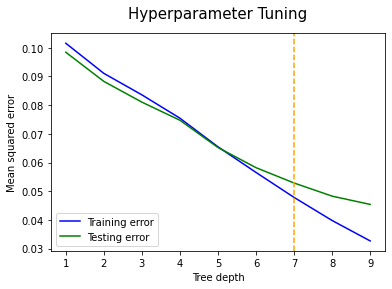

In [96]:
from sklearn.metrics import mean_squared_error as mse

# Plotting
max_depths = range(1, 10)
training_error = []
for max_depth in max_depths:
    model_1 = DecisionTreeRegressor(max_depth=max_depth)
    model_1.fit(x_trainsc, y_train)
    training_error.append(mse(y_train, model_1.predict(x_trainsc)))
    
testing_error = []
for max_depth in max_depths:
    model_2 = DecisionTreeRegressor(max_depth=max_depth)
    model_2.fit(x_trainsc, y_train)
    testing_error.append(mse(y_test, model_2.predict(x_testsc)))

plt.plot(max_depths, training_error, color='blue', label='Training error')
plt.plot(max_depths, testing_error, color='green', label='Testing error')
plt.xlabel('Tree depth')
plt.axvline(x=7, color='orange', linestyle='--')
plt.annotate('optimum = 7', xy=(7.5, 1.17), color='red')
plt.ylabel('Mean squared error')
plt.title('Hyperparameter Tuning', pad=15, size=15)
plt.legend()

In [97]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 50)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'criterion':['squared_error','friedman_mse','absolute_error','poisson'],
                 'max_features':['auto','sqrt','log2'],
                'random_state':[0,3,5,7,]}]



# step-3: perform grid search
# 3.1 specify model
dTree = DecisionTreeRegressor()

dTree.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = dTree,
                        param_grid = hyper_params, 
                        scoring= 'r2', 
                        cv = folds,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

DecisionTreeRegressor()

Fitting 3 folds for each of 48 candidates, totalling 144 fits
Best Score:  0.6829762676251043
Best Params:  {'criterion': 'poisson', 'max_features': 'auto', 'random_state': 7}


In [98]:
dTree2 = DecisionTreeRegressor(criterion='poisson',  max_features='auto', random_state=7)
dTree2.fit(x_trainsc, y_train)
y_predict = dTree2.predict(x_testsc)

print("Decision Tree Model Train Score: ", dTree2.score(x_trainsc , y_train))

print("Decision Tree Model Test Score: ", dTree2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_predict)),2))

print(" ")

y_pred = dTree2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

DecisionTreeRegressor(criterion='poisson', max_features='auto', random_state=7)

Decision Tree Model Train Score:  0.9953818649149783
Decision Tree Model Test Score:  0.7112756743450105


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.14
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.05
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.21
 


<IPython.core.display.Javascript object>

R2=  0.7112756743450105


### Random Forest Regressor

In [99]:
rf_model1= RandomForestRegressor()
rf_model1.fit(x_trainsc, y_train)
rf_model_predict = rf_model1.predict(x_testsc)

print("Random Forest Model Train Score: ", rf_model1.score(x_trainsc , y_train))

print("Random Forest Model Test Score: ", rf_model1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, rf_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, rf_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, rf_model_predict)),2))

print(" ")

y_pred = rf_model1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

RandomForestRegressor()

Random Forest Model Train Score:  0.9775286480381731
Random Forest Model Test Score:  0.8691626454610993


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.1
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.02
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.14
 


<IPython.core.display.Javascript object>

R2=  0.8691626454610993


In [100]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 25)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'criterion':['squared_error','absolute_error','poisson'],
                'max_features':['log2','sqrt',None],
                'random_state':[1,3,5,7],}]



# step-3: perform grid search
# 3.1 specify model
rf = RandomForestRegressor()

rf.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = rf,
                        param_grid = hyper_params, 
                        scoring= 'r2', 
                        cv = folds,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

RandomForestRegressor()

Fitting 3 folds for each of 36 candidates, totalling 108 fits
Best Score:  0.8433669366044959
Best Params:  {'criterion': 'squared_error', 'max_features': None, 'random_state': 5}


In [101]:
rf_model2= RandomForestRegressor( criterion='squared_error', max_features= None, random_state=5)
rf_model2.fit(x_trainsc, y_train)
rf_model_predict = rf_model2.predict(x_testsc)

print("Random Forest Model Train Score: ", rf_model2.score(x_trainsc , y_train))

print("Random Forest Model Test Score: ", rf_model2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, rf_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, rf_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, rf_model_predict)),2))

print(" ")

y_pred = rf_model2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

RandomForestRegressor(max_features=None, random_state=5)

Random Forest Model Train Score:  0.9773567515199917
Random Forest Model Test Score:  0.8684839042871021


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.1
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.02
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.14
 


<IPython.core.display.Javascript object>

R2=  0.8684839042871021


### Gradient Boosting Algorithm

In [102]:
gb_model1= GradientBoostingRegressor()
gb_model1.fit(x_trainsc, y_train)
gb_model_predict = gb_model1.predict(x_testsc)

print("Gradient Boosting Model Train Score: ", gb_model1.score(x_trainsc , y_train))

print("Gradient Boosting Model Test Score: ", gb_model1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, gb_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, gb_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, gb_model_predict)),2))

y_pred = gb_model1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

GradientBoostingRegressor()

Gradient Boosting Model Train Score:  0.7351624382842876
Gradient Boosting Model Test Score:  0.7238595047845136


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.16
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.04
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.21


<IPython.core.display.Javascript object>

R2=  0.7238595047845136


In [103]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 50)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'loss':['squared_error','absolute_error','huber', 'quantile'],
                 'learning_rate': [0,0.1,1,3,5,7,10],
                'criterion':['friedman_mse','squared_error','mse']}]



# step-3: perform grid search
# 3.1 specify model
gb_model= GradientBoostingRegressor()

gb_model.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = gb_model,
                        param_grid = hyper_params, 
                        scoring= 'r2', 
                        cv = folds,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

GradientBoostingRegressor()

Fitting 3 folds for each of 84 candidates, totalling 252 fits
Best Score:  0.7530971110039285
Best Params:  {'criterion': 'squared_error', 'learning_rate': 1, 'loss': 'huber'}


In [104]:
gb_model2= GradientBoostingRegressor( criterion= 'mse', learning_rate= 1, loss= 'huber')
gb_model2.fit(x_trainsc, y_train)
gb_model_predict = gb_model2.predict(x_testsc)

print("Gradient Boosting Model Train Score: ", gb_model2.score(x_trainsc , y_train))

print("Gradient Boosting Model Test Score: ", gb_model2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, gb_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, gb_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, gb_model_predict)),2))

y_pred = gb_model2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

GradientBoostingRegressor(criterion='mse', learning_rate=1, loss='huber')

Gradient Boosting Model Train Score:  0.8372460676419149
Gradient Boosting Model Test Score:  0.7501081345321488


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.15
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.04
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.2


<IPython.core.display.Javascript object>

R2=  0.7501081345321488


### Adaboost

In [105]:
adb_model1= AdaBoostRegressor()
adb_model1.fit(x_trainsc, y_train)
adb_model_predict = adb_model1.predict(x_testsc)

print("Ada  Boosting Model Train Score: ", adb_model1.score(x_trainsc , y_train))

print("Ada Boosting Model Test Score: ", adb_model1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, adb_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, adb_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, adb_model_predict)),2))

y_pred = adb_model1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

AdaBoostRegressor()

Ada  Boosting Model Train Score:  0.5612966764270233
Ada Boosting Model Test Score:  0.5457015776035379


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.22
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.07
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.27


<IPython.core.display.Javascript object>

R2=  0.5457015776035379


In [106]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits =5, shuffle = True, random_state = 50)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'loss':['linear', 'square', 'exponential'],
                 'learning_rate': [1,5,7,10],
                'random_state':[1,3,5,7]}]



# step-3: perform grid search
# 3.1 specify model
adb_model= AdaBoostRegressor()

adb_model.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = adb_model,
                        param_grid = hyper_params, 
                        scoring= 'r2', 
                        cv = folds,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

AdaBoostRegressor()

Fitting 5 folds for each of 48 candidates, totalling 240 fits
Best Score:  0.5779187726940175
Best Params:  {'learning_rate': 5, 'loss': 'exponential', 'random_state': 3}


In [107]:
adb_model2= AdaBoostRegressor(learning_rate=5, loss='exponential', random_state=3)
adb_model2.fit(x_trainsc, y_train)
adb_model_predict = adb_model2.predict(x_testsc)

print("Ada  Boosting Model Train Score: ", adb_model2.score(x_trainsc , y_train))

print("Ada Boosting Model Test Score: ", adb_model2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, adb_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, adb_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, adb_model_predict)),2))

y_pred = adb_model2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

AdaBoostRegressor(learning_rate=5, loss='exponential', random_state=3)

Ada  Boosting Model Train Score:  0.5874990473688253
Ada Boosting Model Test Score:  0.5707961729432969


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 0.21
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 0.07
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 0.26


<IPython.core.display.Javascript object>

R2=  0.5707961729432969


## XXXXXXXXXXXXXX FOR PART 2 XXXXXXXXXXXX

### To Build a Classification model

In [108]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18249 entries, 0 to 18248
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    18249 non-null  int64  
 1   Date          18249 non-null  object 
 2   AveragePrice  18249 non-null  float64
 3   Total Volume  18249 non-null  float64
 4   4046          18249 non-null  float64
 5   4225          18249 non-null  float64
 6   4770          18249 non-null  float64
 7   Total Bags    18249 non-null  float64
 8   Small Bags    18249 non-null  float64
 9   Large Bags    18249 non-null  float64
 10  XLarge Bags   18249 non-null  float64
 11  type          18249 non-null  object 
 12  year          18249 non-null  int64  
 13  region        18249 non-null  object 
dtypes: float64(9), int64(2), object(3)
memory usage: 1.9+ MB


In [109]:
data_class= copy.deepcopy(data)

### Encoding variables

In [113]:
def convert1(val):
    if val == str("TotalUS"):
        return 1        # Total US 
    else:
        return 0        # Cities

In [114]:
# Encoding Region
data_class['region'] = data_class['region'].apply(convert1)

In [118]:
# Encoding data variables using label encoder
enc2= LabelEncoder()
data_class[["type","Date"]]=data_class[["type","Date"]].apply(enc2.fit_transform)

In [119]:
def calc_vif(data):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = data.columns
    vif["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]

    return(vif)

In [120]:
calc_vif(data=data_class.drop([ "region"],axis=1))
# A rule of thumb for interpreting the variance inflation factor:
# 1 = not correlated.
# Between 1 and 5 = moderately correlated.
# Greater than 5 = highly correlated.

<IPython.core.display.Javascript object>

,variables,VIF
0,Unnamed: 0,4.245431e+00
1,Date,5.128212e+00
2,AveragePrice,2.292677e+01
3,Total Volume,5.226792e+09
4,4046,6.966144e+08
5,4225,6.350436e+08
6,4770,4.987102e+06
7,Total Bags,2.502000e+14
8,Small Bags,1.429714e+14
9,Large Bags,1.521486e+13


<Figure size 720x720 with 0 Axes>

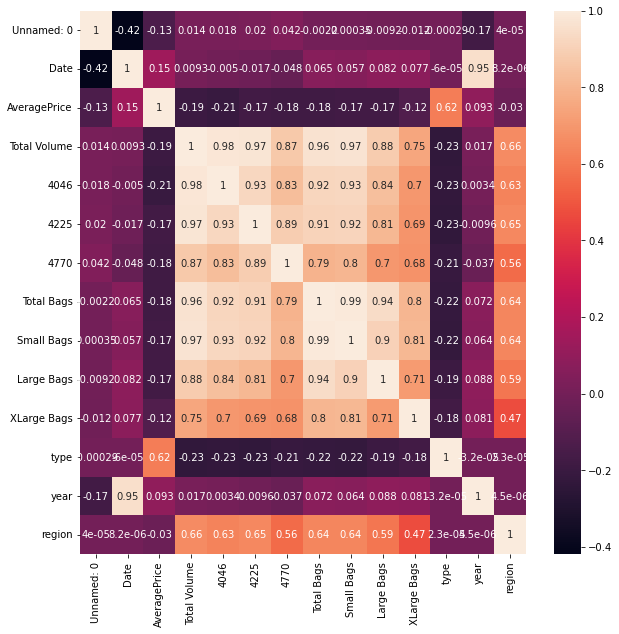

In [121]:
## Plotting Heat Map
plt.figure(figsize=(10,10))                      
plot=sns.heatmap(data_class.corr(method = "pearson"), annot = True)
fig3=plot.get_figure()

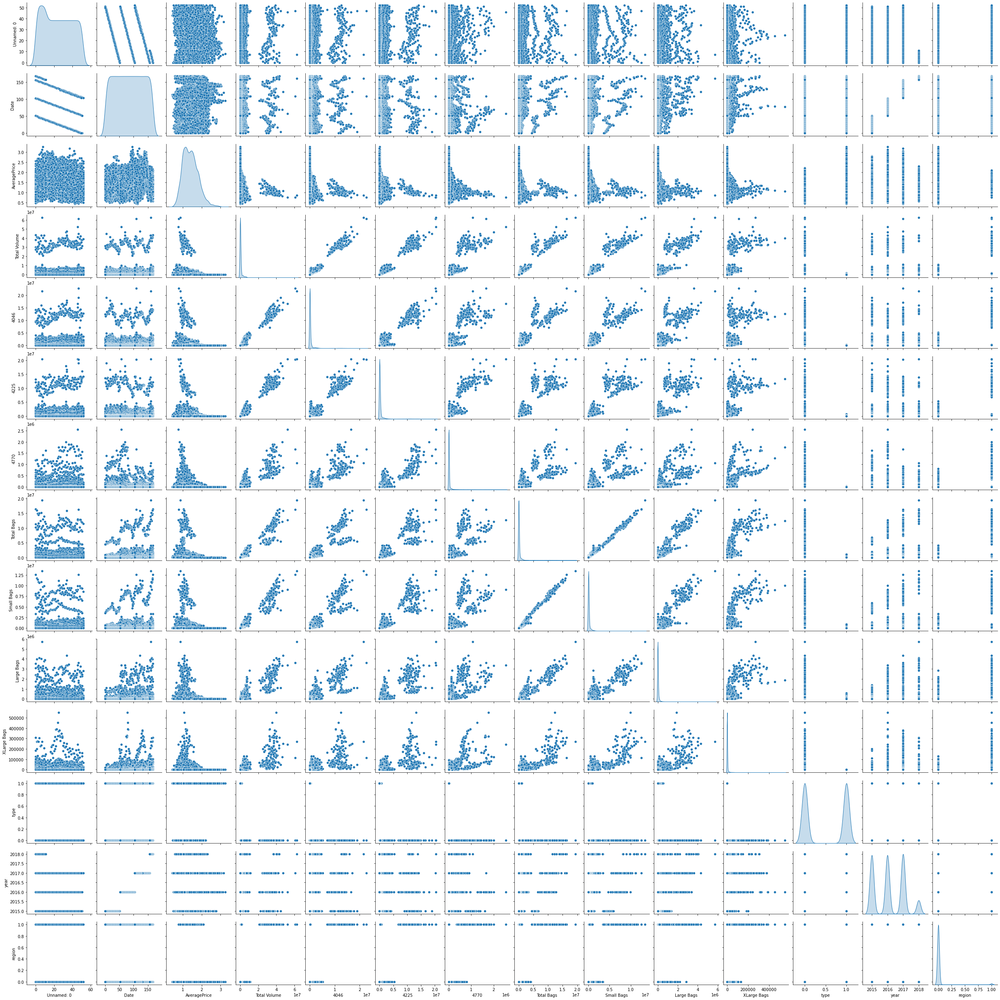

In [122]:
# Plotting graph for each variable
fig1=sns.pairplot(data_class, kind='scatter', diag_kind='kde')

In [124]:
def outlier(mydata):                        # Outlier Plotting
    for i in mydata.columns:
        fig = px.box(mydata, y= i, width=600, height=400, title=i, template="plotly_dark")
        fig.show()

In [125]:
outlier(mydata=data_class)

### Hypothesis Testing

In [212]:
# Creating a cross tab for hypothesis testing year Age and region


crosstab = pd.crosstab(data_class["year"], data_class["region"])

# h0: Average Age of an employee does not affect the attrition rate
# ha: Average Age of an employee does affect the attrition rate

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  0.9999999948149858
Independent (H0 holds true)


In [213]:
# Creating a cross tab for hypothesis testing year type and region


crosstab = pd.crosstab(data_class["type"], data_class["region"])

# h0: Average Age of an employee does not affect the attrition rate
# ha: Average Age of an employee does affect the attrition rate

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  1.0
Independent (H0 holds true)


In [214]:
# Creating a cross tab for hypothesis testing year Unnamed:0 and region


crosstab = pd.crosstab(data_class["Unnamed: 0"], data_class["region"])

# h0: Average Age of an employee does not affect the attrition rate
# ha: Average Age of an employee does affect the attrition rate

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  1.0
Independent (H0 holds true)


In [215]:
# Creating a cross tab for hypothesis testing year Date and region


crosstab = pd.crosstab(data_class["Date"], data_class["region"])

# h0: Average Age of an employee does not affect the attrition rate
# ha: Average Age of an employee does affect the attrition rate

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  1.0
Independent (H0 holds true)


In [127]:
#Dropping inisignificant variables
data_pre=data_class.drop(["Date","year","type"],axis=1)

### Outlier Treatment

In [128]:
for i in data_pre.drop(['region'],axis=1).columns:
    data_pre[i] = np.where(data_pre[i] > (data_pre[i].quantile(0.75) + (data_pre[i].quantile(0.75) - data_pre[i].quantile(0.25))*1.5),
                           (data_pre[i].quantile(0.75) + (data_pre[i].quantile(0.75) - data_pre[i].quantile(0.25))*1.5),
                          np.where(data_pre[i] < (data_pre[i].quantile(0.25) - (data_pre[i].quantile(0.75) - data_pre[i].quantile(0.25))*1.5),
                           (data_pre[i].quantile(0.25) - (data_pre[i].quantile(0.75) - data_pre[i].quantile(0.25))*1.5),data_pre[i]))
    

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

array([[ 0.71029361, -0.73660574],
       [-1.37249558, -0.90719373],
       [ 0.53193774, -0.67826426],
       [ 0.56118416,  1.25087363],
       [ 0.60341561,  1.40632315]])

[0 1 0 2 2 0 1 0 0 1 2 0 2 1 1 2 2 2 2 1 0 2 0 1 0 0 1 1 0 2 2 2 2 2 0 0 0
 0 2 2 1 0 1 1 1 1 1 1 2 1]


3

0

Estimated number of clusters: 3
Estimated number of noise points: 0


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Text(0.5, 1.0, 'Estimated number of clusters: 3')

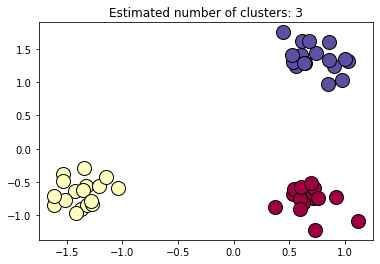

<IPython.core.display.Javascript object>

(array([0, 1, 2], dtype=int64), array([16, 17, 17], dtype=int64))

[]


In [129]:
# DB Scan
data_features= data_pre.drop(["region"],axis=1)
# Data creation
centers = [[1, 1], [-1, -1], [1, -1]]
data_features, labels_true = make_blobs(n_samples=50, centers=centers, cluster_std=0.2,random_state=1)  # generate sample blobs
X = StandardScaler().fit_transform(data_features)
X[:5]

# DBSCAN
db = DBSCAN(eps=0.6, min_samples=4, p= 2).fit(X)

labels = db.labels_  # similar to the model.fit() method, it gives the labels of the clustered data

print (labels)

# Setting Length of labels
len(set(labels))

1 if -1 in labels else 0

# Number of clusters in labels, ignoring noise if present.

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0) # the label -1 is considered as noise by the DBSCAN algorithm
n_noise_ = list(labels).count(-1)  # calculating the number of noises (-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)

# Below code is for showcasing in diagram. Nothing related to model building

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)  # creating an array of true and false as the same size as db.labels

core_samples_mask[db.core_sample_indices_] = True  # setting the indices of the core regions to True
# Black  is used for noise.
unique_labels = set(labels)  # identifying all the unique labels/clusters

colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]  # creating the list of colours, generating the colourmap



for k, col in zip(unique_labels, colors):
    
    
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)   # assigning class members for each class
    

    xy = X[class_member_mask & core_samples_mask] # creating the list of points for each class
    
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)
    

    xy = X[class_member_mask & ~core_samples_mask] # creating the list of noise points
    
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='b', markersize=14)
    
    

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

# Finding counts in each cluster
np.unique(labels, return_counts=True)

# Selecting only noises
noises = X[labels == 4]

print (noises)

In [130]:
data_features1= pd.DataFrame(data_pre.drop(["region"], axis=1))
data_label=pd.DataFrame(data_pre["region"])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [131]:
# Removing skewness using Yeo-Johnson
# Removing data skewness
pt = PowerTransformer(method='yeo-johnson',standardize='True')
    
data_noskew= pt.fit_transform(data_features1.values)
data_noskewtab= pd.DataFrame(data_noskew)


<IPython.core.display.Javascript object>

In [132]:
data_features1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18249 entries, 0 to 18248
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    18249 non-null  float64
 1   AveragePrice  18249 non-null  float64
 2   Total Volume  18249 non-null  float64
 3   4046          18249 non-null  float64
 4   4225          18249 non-null  float64
 5   4770          18249 non-null  float64
 6   Total Bags    18249 non-null  float64
 7   Small Bags    18249 non-null  float64
 8   Large Bags    18249 non-null  float64
 9   XLarge Bags   18249 non-null  float64
dtypes: float64(10)
memory usage: 1.4 MB


In [133]:
data_noskewtab.columns = ['Unnamed: 0', 'AveragePrice', 'Total Volume','4046', '4225', '4770', 
                          'Total Bags', 'Small Bags','Large Bags','XLarge Bags']

print(data_noskewtab)

       Unnamed: 0  AveragePrice  Total Volume      4046      4225      4770  \
0       -1.968845     -0.094667     -0.146630 -0.737354  0.347372 -0.286648   
1       -1.792619     -0.042083     -0.222763 -0.854694  0.252614 -0.238316   
2       -1.648366     -1.274312      0.159021 -0.810504  0.700997 -0.031424   
3       -1.521609     -0.800713     -0.044956 -0.712712  0.485012 -0.182731   
4       -1.406451     -0.228492     -0.257435 -0.764111  0.244122 -0.171705   
...           ...           ...           ...       ...       ...       ...   
18244   -1.104831      0.642931     -0.753675 -0.540557 -1.003643 -1.242467   
18245   -1.014414      0.822937     -0.841751 -0.698199 -0.755715 -1.242467   
18246   -0.927735      1.164822     -0.845454 -0.698146 -0.862228  0.426742   
18247   -0.844286      1.287269     -0.776122 -0.626949 -0.800983  0.426393   
18248   -0.763669      0.619976     -0.743332 -0.434744 -0.874640  0.110962   

       Total Bags  Small Bags  Large Bags  XLarge B

In [134]:
data_final=pd.DataFrame()
data_final=pd.concat([data_clean,data_label], axis=1)
print(data_final)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

       Unnamed: 0  Total Volume      4046      4225      4770  Total Bags  \
0       -1.968845     -0.146630 -0.737354  0.347372 -0.286648   -0.637273   
1       -1.792619     -0.222763 -0.854694  0.252614 -0.238316   -0.597400   
2       -1.648366      0.159021 -0.810504  0.700997 -0.031424   -0.666267   
3       -1.521609     -0.044956 -0.712712  0.485012 -0.182731   -0.810639   
4       -1.406451     -0.257435 -0.764111  0.244122 -0.171705   -0.784680   
...           ...           ...       ...       ...       ...         ...   
18244   -1.104831     -0.753675 -0.540557 -1.003643 -1.242467   -0.434052   
18245   -1.014414     -0.841751 -0.698199 -0.755715 -1.242467   -0.608965   
18246   -0.927735     -0.845454 -0.698146 -0.862228  0.426742   -0.602724   
18247   -0.844286     -0.776122 -0.626949 -0.800983  0.426393   -0.531867   
18248   -0.763669     -0.743332 -0.434744 -0.874640  0.110962   -0.489410   

       Small Bags  Large Bags  XLarge Bags      year  type_organic  region 

<AxesSubplot:ylabel='Density'>

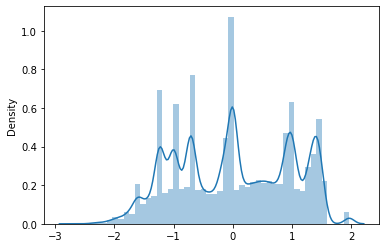

In [135]:
# Dist Plot
sns.distplot(data_final,kde=True, hist=True)

### Splitting the data

In [136]:
def split (data,target):
    data_reset_index = data.reset_index(drop=True)
# Data split
    global x
    global y
    global x_train
    global y_train
    global x_test
    global y_test
# Segregate Feature & Target Variables
    x = data_reset_index.drop(target, axis=1)
    y = data_reset_index[target]
    x_train,x_test,y_train,y_test = train_test_split(x,y, test_size=0.3, random_state=3)
    
    print(x_train.info())
    ("\n")
    print(x_test.info())
    ("\n")
    print(y_train.shape)
    ("\n")
    print(y_test.shape)
    ("\n")

In [137]:
split(data=data_final,
      target="region")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12774 entries, 13042 to 5994
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    12774 non-null  float64
 1   Total Volume  12774 non-null  float64
 2   4046          12774 non-null  float64
 3   4225          12774 non-null  float64
 4   4770          12774 non-null  float64
 5   Total Bags    12774 non-null  float64
 6   Small Bags    12774 non-null  float64
 7   Large Bags    12774 non-null  float64
 8   XLarge Bags   12774 non-null  float64
 9   year          12774 non-null  float64
 10  type_organic  12774 non-null  float64
dtypes: float64(11)
memory usage: 1.2 MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 5475 entries, 2258 to 15115
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    5475 non-null   float64
 1   Total Volume  5475 non-null   float64


### Sorting class imbalance problem

In [139]:
# Smote
sm = SMOTE(random_state = 5)

columns = x_train.columns

train_data = pd.concat([x_train,y_train], axis = 1)

train_data.head()
# Fitting the model
x_os_train, y_os_train  = sm.fit_resample(train_data.drop('region', axis = 1), train_data['region'])

y_os_train.value_counts()

## Number of records in Oversampled Train dataset

print('the number of records in x_os_train :', len(x_os_train))
print('the number of records in y_os_train :', len(y_os_train))
print('the number of records in x_test :', len(x_test))
print('the number of records in y_test :', len(y_test))

# Target Class Distribution for Train and test Dataset

print('the ratio of 0 and 1 in y_os_train:')

print(y_os_train.value_counts(normalize = True)*100)

print('the ratio of 0 and 1 in y_test:')

print(y_test.value_counts(normalize = True)*100)

print("Before UpSampling, counts of label '1': {}".format(sum(y_train==1)))
print("Before UpSampling, counts of label '0': {} \n".format(sum(y_train==0)))

print("After UpSampling, counts of label '1': {}".format(sum(y_os_train==1)))
print("After UpSampling, counts of label '0': {} \n".format(sum(y_os_train==0)))

<IPython.core.display.Javascript object>

,Unnamed: 0,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,year,type_organic,region
13042,-0.324834,-1.062181,-0.479531,-0.818212,-1.242467,-1.094888,-1.438648,0.022927,-0.707352,-0.156623,1.000164,0
8938,-1.406451,0.615986,0.771921,0.571356,0.693216,0.807789,0.906316,0.743654,1.510982,1.968548,-0.999836,0
9165,0.940645,-1.800690,-1.593087,-1.543723,-1.242467,-1.478622,-1.239052,-1.610731,-0.707352,-1.221895,1.000164,0
2510,-0.535871,0.334385,0.788759,0.168917,-0.236111,0.270020,0.436433,0.017633,1.061032,-1.221895,-0.999836,0
520,-1.968845,0.110549,0.523678,0.026625,1.291776,-0.164612,-0.184846,0.191228,1.510982,-1.221895,-0.999836,0


0    12541
1    12541
Name: region, dtype: int64

the number of records in x_os_train : 25082
the number of records in y_os_train : 25082
the number of records in x_test : 5475
the number of records in y_test : 5475
the ratio of 0 and 1 in y_os_train:
0    50.0
1    50.0
Name: region, dtype: float64
the ratio of 0 and 1 in y_test:
0    98.082192
1     1.917808
Name: region, dtype: float64
Before UpSampling, counts of label '1': 233
Before UpSampling, counts of label '0': 12541 

After UpSampling, counts of label '1': 12541
After UpSampling, counts of label '0': 12541 



### Scaling Data

In [142]:
scale_1= StandardScaler()
scale_2= MinMaxScaler()
scale_3= RobustScaler()
model= LinearRegression()

In [143]:
pipe1 = Pipeline([
    ('Scale',scale_1),
    ('model',model),
])    
pipe2 = Pipeline([
    ('Scale',scale_2),
    ('model',model),
])
pipe3 = Pipeline([
    ('Scale',scale_3),
    ('model',model),  
    
])

In [144]:
# Create Function Name 
def pre_process(data, pipe):

# Pipe.fit, pipe.predict and accuracy
    
    pipe.fit(x_train,y_train)
    
    y_pred = pipe.predict(x_test)
    
    score = np.sqrt(metrics.mean_squared_error(y_pred, y_test))
    
    return score

In [145]:
pre_process(data= data_final ,
           pipe= pipe1)

<IPython.core.display.Javascript object>

0.1285268312343549

In [146]:
pre_process(data= data_final,
           pipe= pipe2)

<IPython.core.display.Javascript object>

0.12852683123435493

In [147]:
pre_process(data= data_final,
           pipe= pipe3)

<IPython.core.display.Javascript object>

0.1285268312343549

In [148]:
scalar= RobustScaler()
scalar.fit(x_train)
x_trainsc =  scalar.transform(x_os_train)
x_testsc  =  scalar.transform(x_test)

RobustScaler()

### Principal Component Analysis

In [149]:
pca = PCA(n_components = 0.5)
pca.fit(x_trainsc)
x_train_model = pca.transform(x_trainsc)
x_test_model = pca.transform(x_testsc)
ex_variance=np.var(x_train_model,axis=0)
ex_variance_ratio = ex_variance/np.sum(ex_variance)

print("shape of x_train_pca", x_train_model.shape)
print('')    
print("Explained Variance Ratio for Training Dataset: \n", ex_variance_ratio)

print(" ")

ex_variance_1 = np.var(x_test_model , axis=0)
ex_variance_ratio_1 = ex_variance_1 / np.sum(ex_variance_1)
    
print("Explained Variance Ratio for Test Dataset: \n", ex_variance_ratio_1) 
print(" ")

PCA(n_components=0.5)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

shape of x_train_pca (25082, 1)

Explained Variance Ratio for Training Dataset: 
 [1.]
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Explained Variance Ratio for Test Dataset: 
 [1.]
 


## Model Building

### Naive Baye's Model

In [151]:
nb_model          =      GaussianNB()

## Model.fit

nb_model.fit(x_trainsc, y_os_train)

## Model.predict


y_pred_nb_0 = nb_model.predict(x_testsc)

### Naive Bayes

conf_matrix_nb = confusion_matrix(y_test, y_pred_nb_0, labels=[0, 1])

df_cmatrix_nb = pd.DataFrame(conf_matrix_nb, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_nb = px.imshow(df_cmatrix_nb , title = "Confusion Matrix for NB Classifier Model")

## Saving the Classification Reports : precision, recall, f1-score ##


pred_report_nb = classification_report(y_test, y_pred_nb_0 , digits=2)

### NB Classifier

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test,  y_pred_nb_0)
roc_nb = auc(false_positive_rate, true_positive_rate)


print("The Accuracy Score For The NB Classifier Model Is :  ", accuracy_score(y_test, y_pred_nb_0))
print("\n")
print("The roc_auc score for NB Classifier Model:  ", roc_nb)



##  Confusion Matrices 


fig_cmatrix_nb.show()

### Classification Reports 

print("Title : The Classification Report for NB Classifier Model: \n  ", pred_report_nb)

GaussianNB()

<IPython.core.display.Javascript object>

The Accuracy Score For The NB Classifier Model Is :   0.8989954337899544


The roc_auc score for NB Classifier Model:   0.9438414471934025


Title : The Classification Report for NB Classifier Model: 
                 precision    recall  f1-score   support

           0       1.00      0.90      0.95      5370
           1       0.16      0.99      0.27       105

    accuracy                           0.90      5475
   macro avg       0.58      0.94      0.61      5475
weighted avg       0.98      0.90      0.93      5475



In [152]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(nb_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_pred_nb_0)

print("The Cross Validation Score For Baseline Naive Baye's Model Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Naive Baye's Model Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Naive Baye's Model Classifier Model After Fold Cross Validation Is :  
 [0.86575342 0.8339726  0.76328767 0.77863014 0.7369863  0.99945205
 0.97150685 1.         0.99945205 0.99671053]
 
The Accuracy Score For Baseline Naive Baye's Model Classifier Model After Cross Validation Is: 
 0.8989954337899544


In [153]:
cv_method = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=100)

params_NB = {'var_smoothing': np.logspace(100,-100, num=1000)}

gs_NB = GridSearchCV(estimator=nb_model, 
                     param_grid=params_NB, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_NB.fit(Data_transformed, y_test)

<IPython.core.display.Javascript object>

Fitting 15 folds for each of 1000 candidates, totalling 15000 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=GaussianNB(),
             param_grid={'var_smoothing': array([1.00000000e+100, 6.30666554e+099, 3.97740302e+099, 2.50841506e+099,
       1.58197348e+099, 9.97697764e+098, 6.29214611e+098, 3.96824610e+098,
       2.50264010e+098, 1.57833141e+098, 9.95400829e+097, 6.27766011e+097,
       3.95911027e+097, 2.4...
       6.36507908e-097, 4.01424249e-097, 2.53164848e-097, 1.59662602e-097,
       1.00693863e-097, 6.35042517e-098, 4.00500076e-098, 2.52582003e-098,
       1.59295021e-098, 1.00462042e-098, 6.33580499e-099, 3.99578030e-099,
       2.52000499e-099, 1.58928287e-099, 1.00230755e-099, 6.32121848e-100,
       3.98658107e-100, 2.51420335e-100, 1.58562396e-100, 1.00000000e-100])},
             scoring='accuracy', verbose=1)

In [154]:
print("Best Parameters: ",gs_NB.best_params_)
print("Best Scores: ", gs_NB.best_score_)

Best Parameters:  {'var_smoothing': 1e+100}
Best Scores:  0.9808219178082193


In [156]:
nb_model2          =      GaussianNB(var_smoothing= 1e+100)

## Model.fit

nb_model2.fit(x_trainsc, y_os_train)

## Model.predict


y_pred_nb_0 = nb_model2.predict(x_testsc)

### Naive Bayes

conf_matrix_nb = confusion_matrix(y_test, y_pred_nb_0, labels=[0, 1])

df_cmatrix_nb = pd.DataFrame(conf_matrix_nb, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_nb = px.imshow(df_cmatrix_nb , title = "Confusion Matrix for NB Classifier Model")

## Saving the Classification Reports : precision, recall, f1-score ##


pred_report_nb = classification_report(y_test, y_pred_nb_0 , digits=2)

### NB Classifier

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test,  y_pred_nb_0)
roc_nb = auc(false_positive_rate, true_positive_rate)


print("The Accuracy Score For The NB Classifier Model Is :  ", accuracy_score(y_test, y_pred_nb_0))
print("\n")
print("The roc_auc score for NB Classifier Model:  ", roc_nb)



##  Confusion Matrices 


fig_cmatrix_nb.show()

### Classification Reports 

print("Title : The Classification Report for NB Classifier Model: \n  ", pred_report_nb)

GaussianNB(var_smoothing=1e+100)

<IPython.core.display.Javascript object>

The Accuracy Score For The NB Classifier Model Is :   0.9808219178082191


The roc_auc score for NB Classifier Model:   0.5


Title : The Classification Report for NB Classifier Model: 
                 precision    recall  f1-score   support

           0       0.98      1.00      0.99      5370
           1       0.00      0.00      0.00       105

    accuracy                           0.98      5475
   macro avg       0.49      0.50      0.50      5475
weighted avg       0.96      0.98      0.97      5475



### Linear Discriminant Analysis Model

In [159]:
# Training the model
lda_model         =      LinearDiscriminantAnalysis()

## Model.fit

lda_model.fit(x_trainsc, y_os_train)

## Model.predict

y_lda_0 = lda_model.predict(x_testsc)

## Linear Discriminant Analysis Model


conf_matrix_lda =  confusion_matrix(y_test, y_lda_0 , labels=[0, 1])

df_cmatrix_lda   = pd.DataFrame(conf_matrix_lda , index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_lda = px.imshow(df_cmatrix_lda , title = "Confusion Matrix for Baseline Linear Discriminant Analysis Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_lda = classification_report(y_test, y_lda_0 , digits=2)

### Saving the ROC_AUC Scores for Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_lda_0)
roc_lda = auc(false_positive_rate, true_positive_rate)



##  Confusion Matrices 

fig_cmatrix_lda.show()

### Classification Reports 

print("Title : The Classification Report for Linear Discriminant Model: \n  ", pred_report_lda)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Linear Discriminant Analysis Model Is :  ",   
      accuracy_score(y_test, y_lda_0))

###  roc_auc scores 

print("The roc_auc score for Linear Discriminat Analysis Model:  ", roc_lda)

LinearDiscriminantAnalysis()

<IPython.core.display.Javascript object>

Title : The Classification Report for Linear Discriminant Model: 
                 precision    recall  f1-score   support

           0       1.00      0.87      0.93      5370
           1       0.13      1.00      0.24       105

    accuracy                           0.88      5475
   macro avg       0.57      0.94      0.58      5475
weighted avg       0.98      0.88      0.92      5475

The Accuracy Score For The Linear Discriminant Analysis Model Is :   0.8752511415525114
The roc_auc score for Linear Discriminat Analysis Model:   0.9364059590316574


In [158]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(lda_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_lda_0)

print("The Cross Validation Score For Baseline Linear Discriminant Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Linear Discriminant Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Linear Discriminant Model After Fold Cross Validation Is :  
 [1.         0.97150685 0.99178082 0.97972603 0.96438356 1.
 1.         0.99780822 0.99178082 0.99835526]
 
The Accuracy Score For Baseline Linear Discriminant Model After Cross Validation Is: 
 0.8752511415525114


In [162]:
# Grid Search CV
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=1)
solver= ['svd','lsqr','eigen']
store_covariance= [True,False]
tol=[1,3,5,7,9]
param_grid = dict(solver= solver,
                   store_covariance= store_covariance,
                   tol=tol)

gs_lda = GridSearchCV(estimator=lda_model, 
                     param_grid=param_grid, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_lda.fit(Data_transformed, y_test)

print("The Best Parameters are: ","\n",gs_lda.best_params_)
print("The Best score is: ","\n",gs_lda.best_score_)

Fitting 15 folds for each of 30 candidates, totalling 450 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=LinearDiscriminantAnalysis(),
             param_grid={'solver': ['svd', 'lsqr', 'eigen'],
                         'store_covariance': [True, False],
                         'tol': [1, 3, 5, 7, 9]},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'solver': 'lsqr', 'store_covariance': True, 'tol': 1}
The Best score is:  
 0.9883105022831049


In [164]:
# Training the model
lda_model2 = LinearDiscriminantAnalysis(solver='lsqr', store_covariance=True,tol=1)

## Model.fit

lda_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_lda_0 = lda_model2.predict(x_testsc)

## Linear Discriminant Analysis Model


conf_matrix_lda =  confusion_matrix(y_test, y_lda_0 , labels=[0, 1])

df_cmatrix_lda   = pd.DataFrame(conf_matrix_lda , index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_lda = px.imshow(df_cmatrix_lda , title = "Confusion Matrix for Baseline Linear Discriminant Analysis Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_lda = classification_report(y_test, y_lda_0 , digits=2)

### Saving the ROC_AUC Scores for Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_lda_0)
roc_lda = auc(false_positive_rate, true_positive_rate)



##  Confusion Matrices 

fig_cmatrix_lda.show()

### Classification Reports 

print("Title : The Classification Report for Linear Discriminant Model: \n  ", pred_report_lda)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Linear Discriminant Analysis Model Is :  ",   
      accuracy_score(y_test, y_lda_0))

###  roc_auc scores 

print("The roc_auc score for Linear Discriminat Analysis Model:  ", roc_lda)

LinearDiscriminantAnalysis(solver='lsqr', store_covariance=True, tol=1)

<IPython.core.display.Javascript object>

Title : The Classification Report for Linear Discriminant Model: 
                 precision    recall  f1-score   support

           0       1.00      0.87      0.93      5370
           1       0.13      1.00      0.24       105

    accuracy                           0.88      5475
   macro avg       0.57      0.94      0.58      5475
weighted avg       0.98      0.88      0.92      5475

The Accuracy Score For The Linear Discriminant Analysis Model Is :   0.8752511415525114
The roc_auc score for Linear Discriminat Analysis Model:   0.9364059590316574


### Quadratic Discriminant Analysis Model

In [165]:
# Training the Model

qda_model         =      QuadraticDiscriminantAnalysis()

## Model.fit

qda_model.fit(x_trainsc, y_os_train)

## Model.predict

y_qda_0 = qda_model.predict(x_testsc)

## Quadratic Discriminant Analysis Model

conf_matrix_qda = confusion_matrix(y_test, y_qda_0 , labels=[0, 1])

df_cmatrix_qda = pd.DataFrame(conf_matrix_qda, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_qda = px.imshow(df_cmatrix_qda , title = "Confusion Matrix for Baseline Quadratic Discriminant Analysis Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_qda = classification_report(y_test, y_qda_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_qda_0)
roc_qda = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Quadratic inear Discriminant Analysis Model Is :  ",   
      accuracy_score(y_test, y_qda_0))
###  roc_auc scores 

print("The roc_auc score for Baseline Quadratic Discriminat Analysis Model:  ", roc_qda)

##  Confusion Matrices 

fig_cmatrix_qda.show()

### Classification Reports 

print("Title : The Classification Report for Quadratic Discriminant Model: \n ", pred_report_qda)



QuadraticDiscriminantAnalysis()

<IPython.core.display.Javascript object>

The Accuracy Score For The Quadratic inear Discriminant Analysis Model Is :   0.9415525114155251
The roc_auc score for Baseline Quadratic Discriminat Analysis Model:   0.9655360468209631


Title : The Classification Report for Quadratic Discriminant Model: 
                precision    recall  f1-score   support

           0       1.00      0.94      0.97      5370
           1       0.25      0.99      0.39       105

    accuracy                           0.94      5475
   macro avg       0.62      0.97      0.68      5475
weighted avg       0.99      0.94      0.96      5475



In [166]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(qda_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_qda_0)

print("The Cross Validation Score For Baseline Quadratic Discriminant Model  After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Quadratic Discriminant Model  After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Quadratic Discriminant Model  After Fold Cross Validation Is :  
 [0.93479452 0.8739726  0.87890411 0.87780822 0.90849315 1.
 0.97150685 1.         0.99561644 0.98190789]
 
The Accuracy Score For Baseline Quadratic Discriminant Model  After Cross Validation Is: 
 0.9415525114155251


In [167]:
store_covariance= [True,False]
tol=np.logspace(100,-100, num=10)
param_grid = dict(store_covariance= store_covariance, tol=tol)

gs_qda = GridSearchCV(estimator=qda_model, 
                     param_grid=param_grid, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_qda.fit(Data_transformed, y_test)

print("The Best Parameters are: ","\n",gs_qda.best_params_)
print("The Best score is: ","\n",gs_qda.best_score_)

<IPython.core.display.Javascript object>

Fitting 15 folds for each of 20 candidates, totalling 300 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=QuadraticDiscriminantAnalysis(),
             param_grid={'store_covariance': [True, False],
                         'tol': array([1.00000000e+100, 5.99484250e+077, 3.59381366e+055, 2.15443469e+033,
       1.29154967e+011, 7.74263683e-012, 4.64158883e-034, 2.78255940e-056,
       1.66810054e-078, 1.00000000e-100])},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'store_covariance': True, 'tol': 1e+100}
The Best score is:  
 0.9435616438356164


In [168]:
# Training the Model

qda_model2       =      QuadraticDiscriminantAnalysis(store_covariance=True, tol=1e+100)

## Model.fit

qda_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_qda_0 = qda_model2.predict(x_testsc)

## Quadratic Discriminant Analysis Model

conf_matrix_qda = confusion_matrix(y_test, y_qda_0 , labels=[0, 1])

df_cmatrix_qda = pd.DataFrame(conf_matrix_qda, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_qda = px.imshow(df_cmatrix_qda , title = "Confusion Matrix for Baseline Quadratic Discriminant Analysis Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_qda = classification_report(y_test, y_qda_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_qda_0)
roc_qda = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Quadratic inear Discriminant Analysis Model Is :  ",   
      accuracy_score(y_test, y_qda_0))
###  roc_auc scores 

print("The roc_auc score for Baseline Quadratic Discriminat Analysis Model:  ", roc_qda)

##  Confusion Matrices 

fig_cmatrix_qda.show()

### Classification Reports 

print("Title : The Classification Report for Quadratic Discriminant Model: \n ", pred_report_qda)



QuadraticDiscriminantAnalysis(store_covariance=True, tol=1e+100)

<IPython.core.display.Javascript object>

The Accuracy Score For The Quadratic inear Discriminant Analysis Model Is :   0.9415525114155251
The roc_auc score for Baseline Quadratic Discriminat Analysis Model:   0.9655360468209631


Title : The Classification Report for Quadratic Discriminant Model: 
                precision    recall  f1-score   support

           0       1.00      0.94      0.97      5370
           1       0.25      0.99      0.39       105

    accuracy                           0.94      5475
   macro avg       0.62      0.97      0.68      5475
weighted avg       0.99      0.94      0.96      5475



### K-Nearest Neighbor Analysis Model

In [169]:
# Training the model
knn_model          =       KNeighborsClassifier()

## Model.fit

knn_model.fit(x_trainsc, y_os_train)

## Model.predict

y_knn_0 = knn_model.predict(x_testsc)

## K- Nearest Neighbor Model

conf_matrix_knn = confusion_matrix(y_test, y_knn_0 , labels=[0, 1])

df_cmatrix_knn = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_knn = px.imshow(df_cmatrix_knn , title = "Confusion Matrix for K-Nearest Neighbor Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_knn = classification_report(y_test, y_knn_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_knn_0)
roc_knn = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :  ",   
      accuracy_score(y_test, y_knn_0))

###  roc_auc scores 

print("The roc_auc score for K-Nearest Neighbor Analysis Model:  ", roc_knn)

##  Confusion Matrices 

fig_cmatrix_knn.show()

### Classification Reports 

print("Title : The Classification Report for K-Nearest Neighbor Model: \n ", pred_report_knn)

KNeighborsClassifier()

<IPython.core.display.Javascript object>

The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :   0.9784474885844748
The roc_auc score for K-Nearest Neighbor Analysis Model:   0.8115988294759244


Title : The Classification Report for K-Nearest Neighbor Model: 
                precision    recall  f1-score   support

           0       0.99      0.99      0.99      5370
           1       0.46      0.64      0.53       105

    accuracy                           0.98      5475
   macro avg       0.72      0.81      0.76      5475
weighted avg       0.98      0.98      0.98      5475



In [170]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(knn_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_knn_0)

print("The Cross Validation Score For Baseline K- Nearest Neighbour Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline K- Nearest Neighbour Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline K- Nearest Neighbour Classifier Model After Fold Cross Validation Is :  
 [0.93753425 0.97150685 0.99178082 0.97424658 0.96438356 1.
 1.         1.         0.99835616 0.98519737]
 
The Accuracy Score For Baseline K- Nearest Neighbour Classifier Model After Cross Validation Is: 
 0.9784474885844748


In [171]:
algorithm= ['auto','ball_tree','kd_tree','brute']
metric= ['minkowski','manhattan','euclidean']
n_neighbors= [3,5,7,9,11,13,15]
weights= ['uniform','distance']
p= [1,2]

param_grid = dict(algorithm=algorithm,metric= metric, n_neighbors=n_neighbors, weights=weights, p=p)

gs_knn = GridSearchCV(estimator=knn_model, 
                     param_grid=param_grid, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_knn.fit(Data_transformed, y_test)

print("The Best Parameters are: ","\n",gs_knn.best_params_)
print("The Best score is: ","\n",gs_knn.best_score_)

Fitting 15 folds for each of 336 candidates, totalling 5040 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=KNeighborsClassifier(),
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'metric': ['minkowski', 'manhattan', 'euclidean'],
                         'n_neighbors': [3, 5, 7, 9, 11, 13, 15], 'p': [1, 2],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'algorithm': 'ball_tree', 'metric': 'minkowski', 'n_neighbors': 7, 'p': 1, 'weights': 'uniform'}
The Best score is:  
 0.9883713850837138


In [172]:
# Training the model
knn_model2= KNeighborsClassifier(algorithm='ball_tree', metric='minkowski', n_neighbors=7, p=1, weights='uniform')

## Model.fit

knn_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_knn_0 = knn_model2.predict(x_testsc)

## K- Nearest Neighbor Model

conf_matrix_knn = confusion_matrix(y_test, y_knn_0 , labels=[0, 1])

df_cmatrix_knn = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_knn = px.imshow(df_cmatrix_knn , title = "Confusion Matrix for K-Nearest Neighbor Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_knn = classification_report(y_test, y_knn_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_knn_0)
roc_knn = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :  ",   
      accuracy_score(y_test, y_knn_0))

###  roc_auc scores 

print("The roc_auc score for K-Nearest Neighbor Analysis Model:  ", roc_knn)

##  Confusion Matrices 

fig_cmatrix_knn.show()

### Classification Reports 

print("Title : The Classification Report for K-Nearest Neighbor Model: \n ", pred_report_knn)



KNeighborsClassifier(algorithm='ball_tree', n_neighbors=7, p=1)

<IPython.core.display.Javascript object>

The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :   0.9678538812785388
The roc_auc score for K-Nearest Neighbor Analysis Model:   0.8528864059590316


Title : The Classification Report for K-Nearest Neighbor Model: 
                precision    recall  f1-score   support

           0       0.99      0.97      0.98      5370
           1       0.34      0.73      0.47       105

    accuracy                           0.97      5475
   macro avg       0.67      0.85      0.73      5475
weighted avg       0.98      0.97      0.97      5475



### Support Vector Classification Model

In [174]:
# Training the model
svm_model =  sklearn.svm.SVC()

## Model.fit

svm_model.fit(x_trainsc, y_os_train)

## Model.predict

y_svc_0 = svm_model.predict(x_testsc)

## Support Vector Model

conf_matrix_svc = confusion_matrix(y_test, y_svc_0 , labels=[0, 1])

df_cmatrix_svc = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_svc = px.imshow(df_cmatrix_svc , title = "Confusion Matrix for Support Vector Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_svc = classification_report(y_test, y_svc_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_svc_0)
roc_svc = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Support Vector Analysis Model Is :  ",   
      accuracy_score(y_test, y_svc_0))

###  roc_auc scores 

print("The roc_auc score for Support Vector Analysis Model:  ", roc_svc)
##  Confusion Matrices 

fig_cmatrix_svc.show()

### Classification Reports 

print("Title : The Classification Report for Support Vector Model: \n ", pred_report_svc)


<IPython.core.display.Javascript object>

SVC()

<IPython.core.display.Javascript object>

The Accuracy Score For The Support Vector Analysis Model Is :   0.9431963470319634
The roc_auc score for Support Vector Analysis Model:   0.9710428305400373


Title : The Classification Report for Support Vector Model: 
                precision    recall  f1-score   support

           0       1.00      0.94      0.97      5370
           1       0.25      1.00      0.40       105

    accuracy                           0.94      5475
   macro avg       0.63      0.97      0.69      5475
weighted avg       0.99      0.94      0.96      5475



In [175]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(svm_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_svc_0)

print("The Cross Validation Score For Baseline Support Vector Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Support Vector Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Support Vector Classifier Model After Fold Cross Validation Is :  
 [1.         0.97150685 0.99178082 0.97972603 0.96438356 1.
 0.99945205 1.         0.99890411 0.98245614]
 
The Accuracy Score For Baseline Support Vector Classifier Model After Cross Validation Is: 
 0.9431963470319634


In [179]:
c= [0.1,1,10,100]
class_weights= ['None','balanced']
gamma= ['scale','auto']
kernel=['linear','poly','rbf','sigmoid']
degree=[1,3,5,7,9]

param_grid = dict(C=c,
                  class_weight=class_weights, 
                  gamma=gamma, 
                  kernel=kernel, 
                  degree=degree)

gs_svm = GridSearchCV(estimator=svm_model, 
                     param_grid=param_grid, 
                     cv=cv_method,
                      refit= True,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_svm.fit(x_testsc, y_test)

print("The Best Parameters are: ","\n",gs_svm.best_params_)
print("The Best score is: ","\n",gs_svm.best_score_)

Fitting 15 folds for each of 320 candidates, totalling 4800 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=SVC(),
             param_grid={'C': [0.1, 1, 10, 100],
                         'class_weight': ['None', 'balanced'],
                         'degree': [1, 3, 5, 7, 9], 'gamma': ['scale', 'auto'],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid']},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'C': 100, 'class_weight': 'balanced', 'degree': 7, 'gamma': 'scale', 'kernel': 'poly'}
The Best score is:  
 0.9600608828006086


In [ ]:
# Training the model
svm_model2 =  sklearn.svm.SVC(C=100,  class_weight='balanced', degree=7, gamma='scale', kernel= 'poly')

## Model.fit

svm_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_svc_0 = svm_model2.predict(x_testsc)

## Support Vector Model

conf_matrix_svc = confusion_matrix(y_test, y_svc_0 , labels=[0, 1])

df_cmatrix_svc = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_svc = px.imshow(df_cmatrix_svc , title = "Confusion Matrix for Support Vector Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_svc = classification_report(y_test, y_svc_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_svc_0)
roc_svc = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Support Vector Analysis Model Is :  ",   
      accuracy_score(y_test, y_svc_0))

###  roc_auc scores 

print("The roc_auc score for Support Vector Analysis Model:  ", roc_svc)
##  Confusion Matrices 

fig_cmatrix_svc.show()

### Classification Reports 

print("Title : The Classification Report for Support Vector Model: \n ", pred_report_svc)

### Logistic Regression Model

In [181]:
# Training the model
logit_model = LogisticRegression()

## Model.fit

logit_model.fit(x_trainsc, y_os_train)

## Model.predict

y_logr_0 = logit_model.predict(x_testsc)

## Logistic Regression Model

conf_matrix_logr = confusion_matrix(y_test, y_logr_0 , labels=[0, 1])

df_cmatrix_logr = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_logr = px.imshow(df_cmatrix_logr , title = "Confusion Matrix for Logistic Regression Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_logr = classification_report(y_test, y_logr_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_logr_0)
roc_logr = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Logistic Regression Analysis Model Is :  ",   
      accuracy_score(y_test, y_logr_0))

###  roc_auc scores 

print("The roc_auc score for Logistic Regression Analysis Model:  ", roc_logr)

##  Confusion Matrices 

fig_cmatrix_logr.show()

### Classification Reports 

print("Title : The Classification Report for Logistic Regression Model: \n ", pred_report_logr)



LogisticRegression()

<IPython.core.display.Javascript object>

The Accuracy Score For The Logistic Regression Analysis Model Is :   0.9375342465753425
The roc_auc score for Logistic Regression Analysis Model:   0.9681564245810056


Title : The Classification Report for Logistic Regression Model: 
                precision    recall  f1-score   support

           0       1.00      0.94      0.97      5370
           1       0.23      1.00      0.38       105

    accuracy                           0.94      5475
   macro avg       0.62      0.97      0.67      5475
weighted avg       0.99      0.94      0.96      5475



In [182]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(logit_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_logr_0)

print("The Cross Validation Score For Baseline Logistic Regression Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Logistic Regression Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Logistic Regression Classifier Model After Fold Cross Validation Is :  
 [1.         0.97150685 0.99178082 0.97972603 0.96438356 1.
 1.         1.         0.99890411 0.99945175]
 
The Accuracy Score For Baseline Logistic Regression Classifier Model After Cross Validation Is: 
 0.9375342465753425


In [183]:
### Hyper-parameter Tuning of Logistic Regression

penalty = ['l1', 'l2'] 
C = [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000]
class_weight = ['balanced', None]
solver = ['newton-cg','lbfgs','liblinear','sag','saga']

param_grid = dict(penalty=penalty,
                  C=C,
                  class_weight=class_weight,
                  solver=solver)

grid = GridSearchCV(estimator = logit_model,
                    param_grid = param_grid,
                    scoring ='roc_auc',
                    verbose = 1,
                    n_jobs =-1, cv = 5)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 5 folds for each of 160 candidates, totalling 800 fits
Best Score:  0.9920041976410493
Best Params:  {'C': 1000, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'lbfgs'}


In [191]:
# Training the model
logit_model2 = LogisticRegression(C= 1000, class_weight='balanced', penalty= 'l2', solver= 'lbfgs')

## Model.fit

logit_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_logr_0 = logit_model2.predict(x_testsc)

## Logistic Regression Model

conf_matrix_logr = confusion_matrix(y_test, y_logr_0 , labels=[0, 1])

df_cmatrix_logr = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_logr = px.imshow(df_cmatrix_logr , title = "Confusion Matrix for Logistic Regression Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_logr = classification_report(y_test, y_logr_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_logr_0)
roc_logr = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Logistic Regression Analysis Model Is :  ",   
      accuracy_score(y_test, y_logr_0))

###  roc_auc scores 

print("The roc_auc score for Logistic Regression Analysis Model:  ", roc_logr)

##  Confusion Matrices 

fig_cmatrix_logr.show()

### Classification Reports 

print("Title : The Classification Report for Logistic Regression Model: \n ", pred_report_logr)



LogisticRegression(C=1000, class_weight='balanced')

<IPython.core.display.Javascript object>

The Accuracy Score For The Logistic Regression Analysis Model Is :   0.9618264840182649
The roc_auc score for Logistic Regression Analysis Model:   0.9805400372439478


Title : The Classification Report for Logistic Regression Model: 
                precision    recall  f1-score   support

           0       1.00      0.96      0.98      5370
           1       0.33      1.00      0.50       105

    accuracy                           0.96      5475
   macro avg       0.67      0.98      0.74      5475
weighted avg       0.99      0.96      0.97      5475



### Decision Tree Classifier

DecisionTreeClassifier(random_state=1)

0.9959333386492305
0.9873972602739726


<Figure size 1080x720 with 0 Axes>

[Text(0.2457268320322337, 0.9893617021276596, 'X[3] <= 0.587\ngini = 0.5\nsamples = 25082\nvalue = [12541, 12541]'),
 Text(0.2296099848904558, 0.9680851063829787, 'X[3] <= 0.575\ngini = 0.005\nsamples = 10040\nvalue = [10017, 23]'),
 Text(0.22155156131956685, 0.9468085106382979, 'gini = 0.0\nsamples = 9953\nvalue = [9953, 0]'),
 Text(0.23766840846134474, 0.9468085106382979, 'X[10] <= 0.5\ngini = 0.389\nsamples = 87\nvalue = [64, 23]'),
 Text(0.2296099848904558, 0.925531914893617, 'gini = 0.0\nsamples = 64\nvalue = [64, 0]'),
 Text(0.2457268320322337, 0.925531914893617, 'gini = 0.0\nsamples = 23\nvalue = [0, 23]'),
 Text(0.2618436791740116, 0.9680851063829787, 'X[7] <= 0.557\ngini = 0.279\nsamples = 15042\nvalue = [2524, 12518]'),
 Text(0.25378525560312265, 0.9468085106382979, 'gini = 0.0\nsamples = 1173\nvalue = [1173, 0]'),
 Text(0.2699021027449005, 0.9468085106382979, 'X[2] <= 0.492\ngini = 0.176\nsamples = 13869\nvalue = [1351, 12518]'),
 Text(0.2618436791740116, 0.925531914893617, 

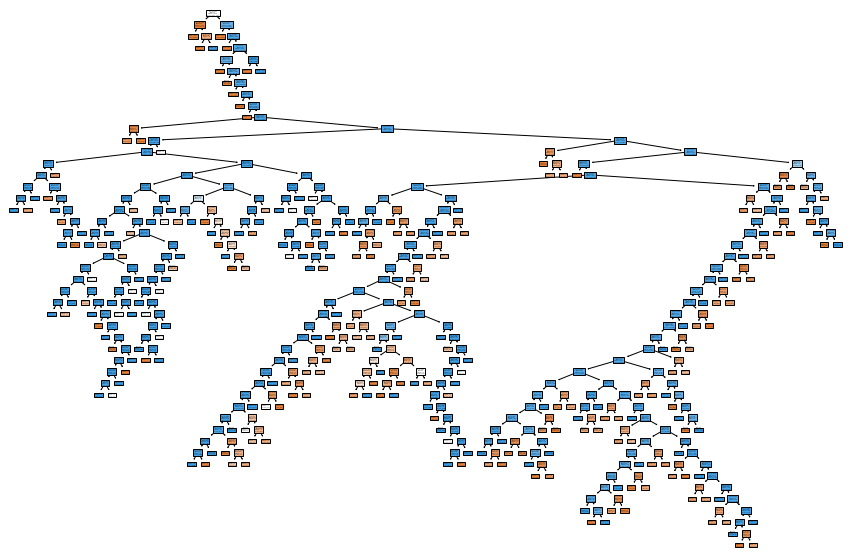

In [185]:
# Building Decision Tree Model
dTree = DecisionTreeClassifier(criterion = 'gini', random_state=1)
dTree.fit(x_trainsc, y_os_train)

# Scoring our Decision Tree
print(dTree.score(x_trainsc, y_os_train))
print(dTree.score(x_testsc, y_test))


# Visualizing the Decision Tree
plt.figure(figsize=(15,10))
tree.plot_tree(dTree,filled=True)



In [186]:
# Reducing Overfitting
dTreeR = DecisionTreeClassifier(criterion = 'gini', max_depth = 4, random_state=1)
dTreeR.fit(x_trainsc, y_os_train)
print(dTreeR.score(x_trainsc, y_os_train))
print(dTreeR.score(x_testsc, y_test))

DecisionTreeClassifier(max_depth=4, random_state=1)

0.9522366637429233
0.9101369863013699


0.9101369863013699


<IPython.core.display.Javascript object>

<Figure size 504x360 with 0 Axes>

<AxesSubplot:>

Accuracy Score for Decision Tree:  0.9101369863013699


Decision Tree Classifier Report


              precision    recall  f1-score   support

           0       1.00      0.91      0.95      5370
           1       0.17      0.99      0.30       105

    accuracy                           0.91      5475
   macro avg       0.59      0.95      0.62      5475
weighted avg       0.98      0.91      0.94      5475



ROC score:  0.9495211492418196


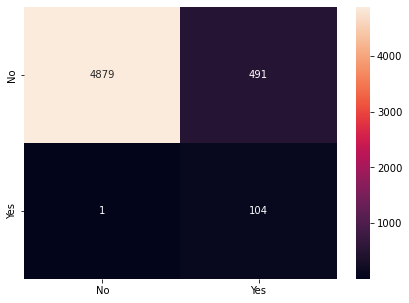

In [187]:
# Decision Tree Analysis Model
print(dTreeR.score(x_testsc , y_test))
y_predict = dTreeR.predict(x_testsc)

cm = confusion_matrix(y_test, y_predict, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["No","Yes"]],
                  columns = [i for i in ["No","Yes"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True ,fmt='g')

## Saving the Classification Reports for Meta Learning Models:

pred_report_tree = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_tree = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Decision Tree: ",accuracy)
print("\n")
print("Decision Tree Classifier Report")
print("\n")
print(pred_report_tree)
print("\n")
print("ROC score: ",roc_tree)

In [188]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(dTree , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Decision Tree Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Decision Tree Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Decision Tree Classifier Model After Fold Cross Validation Is :  
 [0.95506849 0.97150685 0.99178082 0.97972603 0.96438356 1.
 0.97260274 1.         0.99726027 0.99506579]
 
The Accuracy Score For Baseline Decision Tree Classifier Model After Cross Validation Is: 
 0.9101369863013699


In [189]:
### Hyper-parameter Tuning of Decision Tree by Grid Search CV 
criterion = ['gini','entropy','log_class']
max_depth = [1,3,5,7]
max_features = ['sqrt','log2',None]
random_state=[1,5,7,10]

param_grid = dict(criterion=criterion,
                  max_depth=max_depth,
                  max_features=max_features,
                  random_state=random_state)

grid = GridSearchCV(estimator = dTree,
                    param_grid = param_grid,
                    scoring ='accuracy',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 10)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 10 folds for each of 144 candidates, totalling 1440 fits
Best Score:  0.9796269156713662
Best Params:  {'criterion': 'entropy', 'max_depth': 7, 'max_features': None, 'random_state': 1}


DecisionTreeClassifier(criterion='entropy', max_depth=7, random_state=1)

0.9796666932461526
0.9631050228310503
0.9631050228310503


<IPython.core.display.Javascript object>

<Figure size 504x360 with 0 Axes>

<AxesSubplot:>

Accuracy Score for Decision Tree:  0.9631050228310503


Decision Tree Classifier Report


              precision    recall  f1-score   support

           0       1.00      0.96      0.98      5370
           1       0.34      0.99      0.51       105

    accuracy                           0.96      5475
   macro avg       0.67      0.98      0.74      5475
weighted avg       0.99      0.96      0.97      5475



ROC score:  0.9765230114392125


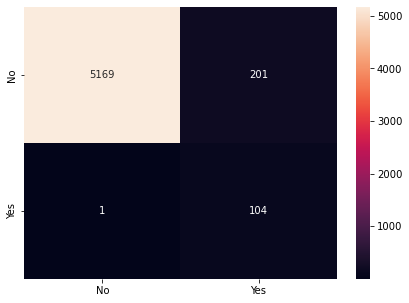

In [194]:
dTreeR2 = DecisionTreeClassifier(criterion = 'entropy', max_depth = 7, max_features=None, random_state=1)
dTreeR2.fit(x_trainsc, y_os_train)
print(dTreeR2.score(x_trainsc, y_os_train))
print(dTreeR2.score(x_testsc, y_test))

# Decision Tree Analysis Model
print(dTreeR2.score(x_testsc , y_test))
y_predict = dTreeR2.predict(x_testsc)
cm = confusion_matrix(y_test, y_predict, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["No","Yes"]],
                  columns = [i for i in ["No","Yes"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True ,fmt='g')

## Saving the Classification Reports for Meta Learning Models:

pred_report_tree = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_tree = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Decision Tree: ",accuracy)
print("\n")
print("Decision Tree Classifier Report")
print("\n")
print(pred_report_tree)
print("\n")
print("ROC score: ",roc_tree)

### Ranom Forest Variable

In [195]:
rf_model = RandomForestClassifier()
rf_model.fit(x_trainsc, y_os_train)
y_predict= rf_model.predict(x_testsc)

## Saving the Classification Reports for Meta Learning Models:

pred_report_rf = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_rf = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Random Forest: ",accuracy)
print("\n")
print("ROC score: ",roc_rf)
print("\n")
print("Random Forest Classifier Report")
print("\n")
print(pred_report_rf)

RandomForestClassifier()

Accuracy Score for Random Forest:  0.9842922374429224


ROC score:  0.7352088321362065


Random Forest Classifier Report


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      5370
           1       0.62      0.48      0.54       105

    accuracy                           0.98      5475
   macro avg       0.80      0.74      0.76      5475
weighted avg       0.98      0.98      0.98      5475



In [196]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(rf_model , x , y, scoring = 'accuracy', cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Random Forest Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Random Forest Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Random Forest Classifier Model After Fold Cross Validation Is :  
 [0.96876712 0.97150685 0.99178082 0.97315068 0.96438356 1.
 0.97150685 1.         0.99945205 0.99616228]
 
The Accuracy Score For Baseline Random Forest Model After Cross Validation Is: 
 0.9842922374429224


In [197]:
### Hyper-parameter Tuning of Random Forest Classifier

n_estimators = [1,10,100] 
criterion = ['gini','entropy','log_class']
max_features = ['sqrt','log2',None]
bootstrap=[True,False]
random_state=[1,5,7,10]
class_weight=['balanced','balanced_subsample', None]

param_grid = dict(n_estimators=n_estimators,
                  criterion=criterion,
                  max_features=max_features,
                  bootstrap=bootstrap,
                  random_state=random_state,
                  class_weight=class_weight)

grid = GridSearchCV(estimator = rf_model,
                    param_grid = param_grid,
                    scoring ='accuracy',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 3)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 3 folds for each of 648 candidates, totalling 1944 fits
Best Score:  0.9880792276817997
Best Params:  {'bootstrap': False, 'class_weight': None, 'criterion': 'entropy', 'max_features': None, 'n_estimators': 1, 'random_state': 1}


In [199]:
rf_model2 = RandomForestClassifier(bootstrap= False, class_weight= None, criterion= 'entropy', max_features= None, n_estimators= 1, random_state= 1)
rf_model2.fit(x_trainsc, y_os_train)
y_predict= rf_model2.predict(x_testsc)

## Saving the Classification Reports for Meta Learning Models:

pred_report_rf = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_rf = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Random Forest: ",accuracy)
print("\n")
print("ROC score: ",roc_rf)
print("\n")
print("Random Forest Classifier Report")
print("\n")
print(pred_report_rf)

RandomForestClassifier(bootstrap=False, criterion='entropy', max_features=None,
                       n_estimators=1, random_state=1)

Accuracy Score for Random Forest:  0.9873972602739726


ROC score:  0.7321229050279331


Random Forest Classifier Report


              precision    recall  f1-score   support

           0       0.99      1.00      0.99      5370
           1       0.79      0.47      0.59       105

    accuracy                           0.99      5475
   macro avg       0.89      0.73      0.79      5475
weighted avg       0.99      0.99      0.99      5475



### Ada Boosting Classifier Algorithm

In [200]:
clf = AdaBoostClassifier()
clf.fit(x_trainsc, y_os_train)
y_pred = clf.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_1 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
print("\n")
print("roc_auc_1 score: ", roc_auc_1)
########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))




AdaBoostClassifier()

Accuracy Score:  0.9640182648401826


roc_auc_1 score:  0.9536445863261506
              precision    recall  f1-score   support

           0       1.00      0.96      0.98      5370
           1       0.34      0.94      0.50       105

    accuracy                           0.96      5475
   macro avg       0.67      0.95      0.74      5475
weighted avg       0.99      0.96      0.97      5475



In [201]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(clf , x , y, scoring = 'accuracy', cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Ada Boosting Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Ada Boosting Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Ada Boosting Classifier Model After Fold Cross Validation Is :  
 [0.95178082 0.97150685 0.99123288 0.97972603 0.96438356 1.
 0.97753425 0.99945205 0.99945205 0.97807018]
 
The Accuracy Score For Baseline Ada Boosting Classifier Model After Cross Validation Is: 
 0.9873972602739726


In [202]:
### Hyper-parameter Tuning of Random Forest Classifier

n_estimators = [1,10,100] 
learning_rate= [1,5,7,10]
algorithm= ['SAMME', 'SAMME.R']
random_state=[1,3,5,7,10,11,15,20]

param_grid = dict(n_estimators=n_estimators,
                  learning_rate=learning_rate,
                  random_state=random_state,
                  algorithm=algorithm)

grid = GridSearchCV(estimator = clf,
                    param_grid = param_grid,
                    scoring ='accuracy',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 5)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 5 folds for each of 192 candidates, totalling 960 fits
Best Score:  0.9813412547259572
Best Params:  {'algorithm': 'SAMME.R', 'learning_rate': 1, 'n_estimators': 100, 'random_state': 1}


In [206]:
clf2 = AdaBoostClassifier(n_estimators =100 ,learning_rate= 1,algorithm='SAMME.R' , random_state= 1)
clf2.fit(x_trainsc, y_os_train)
y_pred= clf2.predict(x_testsc)
### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_1 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
print("\n")
print("roc_auc_1 score: ", roc_auc_1)
########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))

AdaBoostClassifier(learning_rate=1, n_estimators=100, random_state=1)

Accuracy Score:  0.9645662100456621


roc_auc_1 score:  0.9492551210428306
              precision    recall  f1-score   support

           0       1.00      0.97      0.98      5370
           1       0.34      0.93      0.50       105

    accuracy                           0.96      5475
   macro avg       0.67      0.95      0.74      5475
weighted avg       0.99      0.96      0.97      5475



### Gradient Boosting Algorithm

In [207]:
clf3 = GradientBoostingClassifier()
clf3.fit(x_trainsc, y_os_train)
y_pred = clf3.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_2 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
########## Printing the ROC_AOC Score

print("roc_auc_2 score: ", roc_auc_2)

########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))

GradientBoostingClassifier()

Accuracy Score:  0.9621917808219178
roc_auc_2 score:  0.9667198723064645
              precision    recall  f1-score   support

           0       1.00      0.96      0.98      5370
           1       0.33      0.97      0.50       105

    accuracy                           0.96      5475
   macro avg       0.67      0.97      0.74      5475
weighted avg       0.99      0.96      0.97      5475



In [208]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(clf3 , x , y, scoring = 'accuracy', cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Gradient Boosting Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Gradient Boosting Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Gradient Boosting Classifier Model After Fold Cross Validation Is :  
 [0.95726027 0.97150685 0.99178082 0.97972603 0.96438356 1.
 0.97150685 1.         1.         0.99890351]
 
The Accuracy Score For Baseline Gradient Boosting Classifier Model After Cross Validation Is: 
 0.9873972602739726


In [211]:
### Hyper-parameter Tuning of Gradient Boosting Classifier

loss = ['log_loss','deviance','exponential'] 
learning_rate= [1,5,7,10]
criterion= ['friedman_mse', 'squared_error','mse']
random_state=[1,3,5,7]
max_features=['auto','sqrt','log2']

param_grid = dict(loss=loss,
                  learning_rate=learning_rate,
                  criterion=criterion,
                  max_features=max_features,
                  random_state=random_state)

grid = GridSearchCV(estimator = clf3,
                    param_grid = param_grid,
                    scoring ='roc_auc',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 3)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 3 folds for each of 432 candidates, totalling 1296 fits
Best Score:  0.9997540653713642
Best Params:  {'criterion': 'friedman_mse', 'learning_rate': 1, 'loss': 'exponential', 'max_features': 'auto', 'random_state': 7}


In [218]:
clf4 = GradientBoostingClassifier(loss ='exponential' ,learning_rate=1 ,max_features='auto' ,criterion='friedman_mse' , 
                                  random_state=15 )
clf4.fit(x_trainsc, y_os_train)
y_pred = clf4.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_2 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
########## Printing the ROC_AOC Score

print("roc_auc_2 score: ", roc_auc_2)

########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))




GradientBoostingClassifier(learning_rate=1, loss='exponential',
                           max_features='auto', random_state=15)

Accuracy Score:  0.9866666666666667
roc_auc_2 score:  0.7317504655493483
              precision    recall  f1-score   support

           0       0.99      1.00      0.99      5370
           1       0.74      0.47      0.57       105

    accuracy                           0.99      5475
   macro avg       0.87      0.73      0.78      5475
weighted avg       0.98      0.99      0.99      5475



In [216]:
## Saving Best Regression Model
saved_model1 = pickle.dumps(rf_model1)

In [217]:
## Saving Best Classification Model
saved_model2 = pickle.dumps(rf_model2)

## Conclusion:

For commercial use this case study could be of very crucial use. By regression model we can predict the prices and increase profits by planned purchasing and sales.
In case of classification model our precision is more important than recall. A True Positive is of less importance compared to False Negative. Monetarily speaking, we can analyze our market and develop for more market capture.